In [7]:
import numpy as np
from scipy import stats
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

import os
import sys
src_path = os.path.abspath(os.path.join(os.getcwd(), "../src"))
if src_path not in sys.path:
    sys.path.append(src_path)
from variables import STATE_VARIABLES, ACTION_VARIABLES, TARGET_VARIABLES


## Load and prepare data

In [48]:
# Load data, encode cyclic variables and normalize

# --------------------------
# 1. Load data
# --------------------------
df = pd.read_csv('../data/train/df_1/observations.csv', sep=',')
print("Original shape:", df.shape)

# --------------------------
# 2. Encode cyclic variables
# --------------------------
def encode_cyclic(df, column, period):
    df[column + '_sin'] = np.sin(2 * np.pi * df[column] / period)
    df[column + '_cos'] = np.cos(2 * np.pi * df[column] / period)
    return df

cyclic_columns = {
    'month': 12,
    'day_of_month': 31,
    'hour': 24,
    'minutes': 60
}

for col, period in cyclic_columns.items():
    df = encode_cyclic(df, col, period)

# Drop original columns after encoding
#df = df.drop(list(cyclic_columns.keys()), axis=1)

# --------------------------
# 3. Standardize numeric variables
# --------------------------
numeric_cols = df.select_dtypes(include=np.number).columns.tolist()

# Exclude cyclic features from standardization (they are already in [-1,1])
cyclic_features = [c for c in df.columns if c.endswith('_sin') or c.endswith('_cos')]
numeric_to_scale = [c for c in numeric_cols if c not in cyclic_features]

scaler = StandardScaler()
df[numeric_to_scale] = scaler.fit_transform(df[numeric_to_scale])

# --------------------------
# 4. Check result
# --------------------------
print("Final shape:", df.shape)
print(df.head())

Original shape: (30519, 46)
Final shape: (30519, 54)
     month  day_of_month      hour   minutes  outdoor_temperature  \
0  0.87978     -1.672094 -1.661243 -1.470908             1.838809   
1  0.87978     -1.672094 -1.661243 -0.885813             1.763701   
2  0.87978     -1.672094 -1.661243 -0.300718             1.688593   
3  0.87978     -1.672094 -1.661243  0.284376             1.613485   
4  0.87978     -1.672094 -1.661243  0.869471             1.538377   

   outdoor_humidity  wind_speed  wind_direction  diffuse_solar_radiation  \
0          0.335721    0.965287        0.744039                -0.531454   
1          0.444902    0.614217        0.919298                -0.531454   
2          0.554083    0.263147        1.094557                -0.531454   
3          0.663264   -0.087923        1.269816                -0.531454   
4          0.772445   -0.438992        1.445075                -0.531454   

   direct_solar_radiation  ...  cop_temp_mod  plr_current  month_sin  \
0  

In [49]:
# Classify variables

# Suponiendo que ya tienes df con las columnas codificadas cíclicamente
all_columns = df.columns.tolist()

# Detectar las columnas cíclicas recién creadas
cyclic_columns = [c for c in all_columns if c.endswith('_sin') or c.endswith('_cos')]

# STATE: todas las originales de STATE_VARIABLES + cyclic features
state_cols = [c for c in all_columns if c in STATE_VARIABLES] + cyclic_columns

# ACTION y TARGET según variables.py
action_cols = [c for c in all_columns if c in ACTION_VARIABLES]
target_cols = [c for c in all_columns if c in TARGET_VARIABLES]

# Crear sub-DataFrames
state_df = df[state_cols]
action_df = df[action_cols]
target_df = df[target_cols]

# Comprobación rápida
print("State columns:", len(state_df.columns), state_df.columns.values)
print("Action columns:", len(action_df.columns), action_df.columns.values)
print("Target columns:", len(target_df.columns), target_df.columns.values)

State columns: 48 ['month' 'day_of_month' 'hour' 'minutes' 'outdoor_temperature'
 'outdoor_humidity' 'wind_speed' 'wind_direction'
 'diffuse_solar_radiation' 'direct_solar_radiation' 'htg_setpoint_living'
 'htg_setpoint_kitchen' 'htg_setpoint_bed1' 'htg_setpoint_bed2'
 'htg_setpoint_bed3' 'air_temperature_living' 'air_temperature_kitchen'
 'air_temperature_bed1' 'air_temperature_bed2' 'air_temperature_bed3'
 'air_humidity_living' 'air_humidity_kitchen' 'air_humidity_bed1'
 'air_humidity_bed2' 'air_humidity_bed3'
 'radiant_hvac_outlet_temperature_living'
 'radiant_hvac_outlet_temperature_kitchen'
 'radiant_hvac_outlet_temperature_bed1'
 'radiant_hvac_outlet_temperature_bed2'
 'radiant_hvac_outlet_temperature_bed3' 'heat_source_electricity_rate'
 'heat_source_load_side_outlet_temp' 'heat_source_load_side_inlet_temp'
 'heat_source_load_side_heat_transfer_rate'
 'heat_source_load_side_mass_flow_rate' 'crf' 'heat_cap_mod' 'cop_plr_mod'
 'cop_temp_mod' 'plr_current' 'month_sin' 'month_cos' '

## Correlations State-Target variables
- Para construir el modelo podrían descargarse variables state poco correlacionadas con las target, ya que queremos predecir las segundas a partir de las primeras

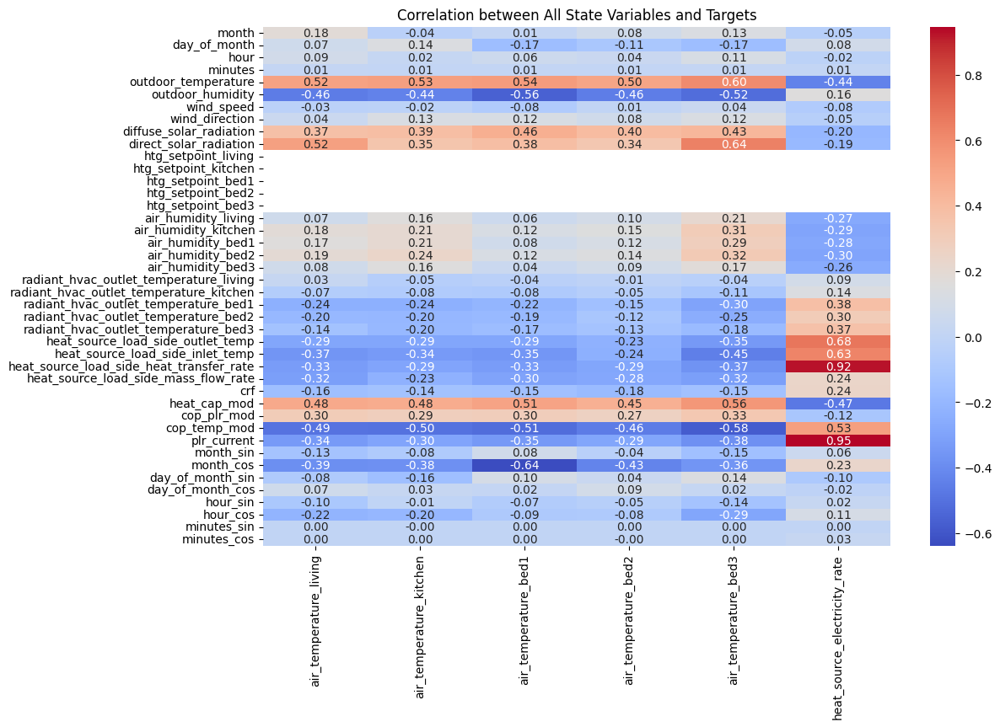


Ranking de todas las variables state por correlación promedio con los targets:


,Average |Correlation|
outdoor_temperature,0.520827
cop_temp_mod,0.510803
heat_cap_mod,0.492244
plr_current,0.433750
outdoor_humidity,0.431989
heat_source_load_side_heat_transfer_rate,0.422504
month_cos,0.405672
direct_solar_radiation,0.403894
heat_source_load_side_inlet_temp,0.395454
diffuse_solar_radiation,0.374454



Variables descartadas por tener |correlation| <= 0.1 con todos los targets:
['minutes', 'wind_speed', 'htg_setpoint_living', 'htg_setpoint_kitchen', 'htg_setpoint_bed1', 'htg_setpoint_bed2', 'htg_setpoint_bed3', 'radiant_hvac_outlet_temperature_living', 'day_of_month_cos', 'minutes_sin', 'minutes_cos']


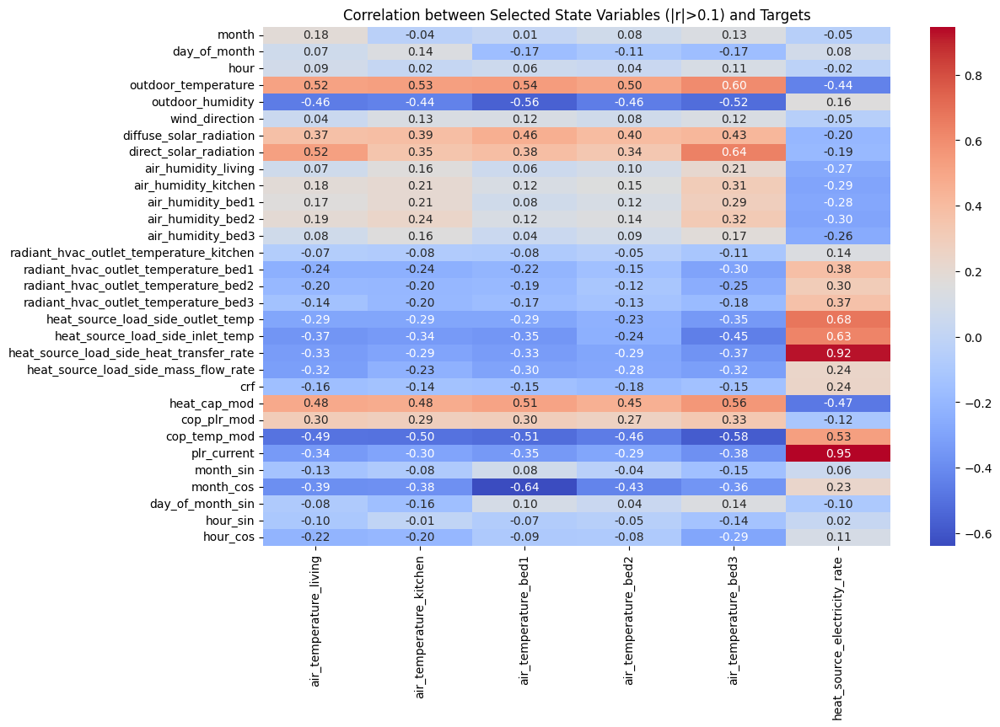

In [50]:
# --------------------------
# Parámetro
# --------------------------
threshold = 0.1  # umbral absoluto de correlación

# --------------------------
# Remover columnas objetivo de state_df si existen
# --------------------------
state_only_df = state_df.drop(columns=[c for c in target_df.columns if c in state_df.columns])

# --------------------------
# Matriz de correlación completa (todas las state vs targets)
# --------------------------
full_corr_matrix = state_only_df.join(target_df).corr().loc[state_only_df.columns, target_df.columns]

# --------------------------
# Heatmap de todas las variables de estado vs targets
# --------------------------
plt.figure(figsize=(12,8))
sns.heatmap(full_corr_matrix, cmap='coolwarm', annot=True, fmt=".2f")
plt.title("Correlation between All State Variables and Targets")
plt.show()

# --------------------------
# Ranking por correlación promedio absoluta
# --------------------------
avg_corr = full_corr_matrix.abs().mean(axis=1).sort_values(ascending=False)
print("\nRanking de todas las variables state por correlación promedio con los targets:")
display(avg_corr.to_frame(name="Average |Correlation|"))

# --------------------------
# Filtrar variables según el umbral
# --------------------------
mask = (full_corr_matrix.abs() > threshold).any(axis=1)
filtered_state_df = state_only_df.loc[:, mask]

# Variables descartadas
discarded_vars = [col for col in state_only_df.columns if col not in filtered_state_df.columns]
if discarded_vars:
    print(f"\nVariables descartadas por tener |correlation| <= {threshold} con todos los targets:")
    print(discarded_vars)
else:
    print("\nNo se descartó ninguna variable.")

# --------------------------
# Heatmap para variables filtradas
# --------------------------
if not filtered_state_df.empty:
    filtered_corr_matrix = filtered_state_df.join(target_df).corr().loc[filtered_state_df.columns, target_df.columns]
    plt.figure(figsize=(12,8))
    sns.heatmap(filtered_corr_matrix, cmap='coolwarm', annot=True, fmt=".2f")
    plt.title(f"Correlation between Selected State Variables (|r|>{threshold}) and Targets")
    plt.show()
else:
    print("No hay variables que cumplan el umbral.")

## Correlations State-State variables
- Para construir el modelo podrían descargarse variables state muy correlacionadas entre sí, ya que no aportarán mucho al modelo predictivo de las target

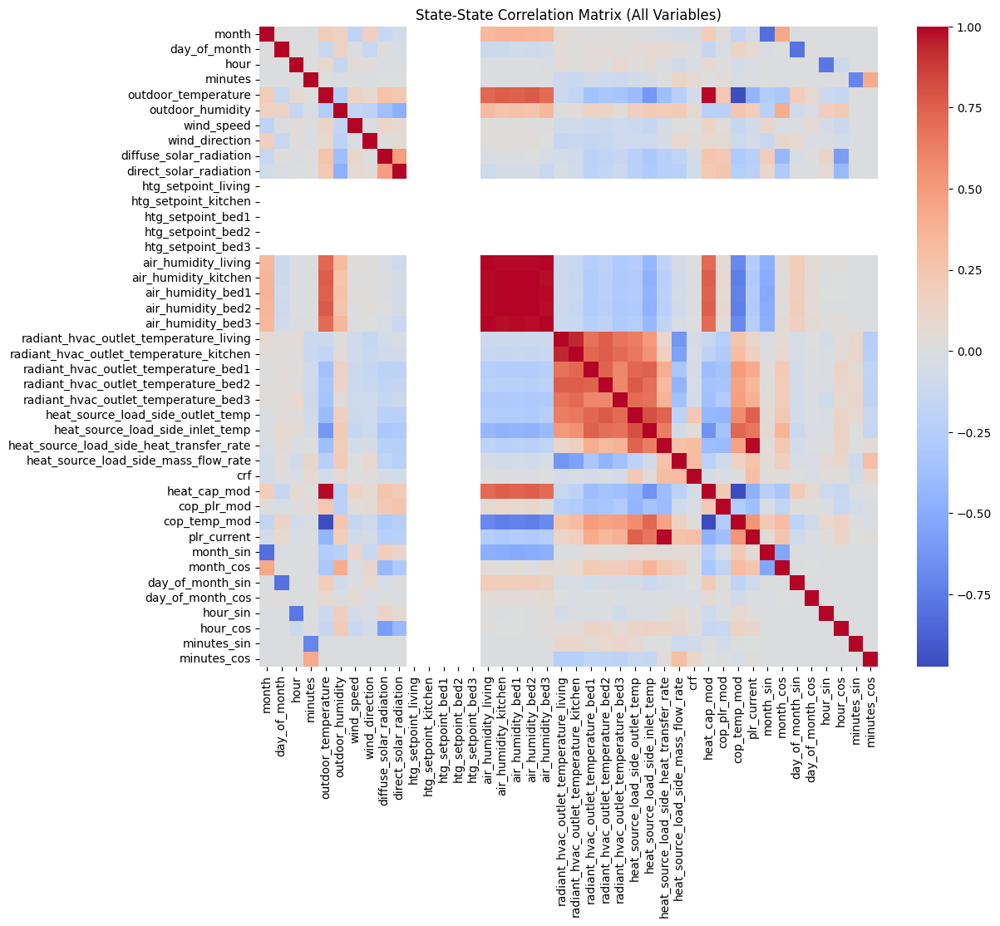


Variables con correlaciones > 0.9:
outdoor_temperature: ['heat_cap_mod', 'cop_temp_mod']
air_humidity_living: ['air_humidity_kitchen', 'air_humidity_bed1', 'air_humidity_bed2', 'air_humidity_bed3']
air_humidity_kitchen: ['air_humidity_living', 'air_humidity_bed1', 'air_humidity_bed2', 'air_humidity_bed3']
air_humidity_bed1: ['air_humidity_living', 'air_humidity_kitchen', 'air_humidity_bed2', 'air_humidity_bed3']
air_humidity_bed2: ['air_humidity_living', 'air_humidity_kitchen', 'air_humidity_bed1', 'air_humidity_bed3']
air_humidity_bed3: ['air_humidity_living', 'air_humidity_kitchen', 'air_humidity_bed1', 'air_humidity_bed2']
radiant_hvac_outlet_temperature_living: ['radiant_hvac_outlet_temperature_kitchen']
radiant_hvac_outlet_temperature_kitchen: ['radiant_hvac_outlet_temperature_living']
heat_source_load_side_heat_transfer_rate: ['plr_current']
heat_cap_mod: ['outdoor_temperature', 'cop_temp_mod']
cop_temp_mod: ['outdoor_temperature', 'heat_cap_mod']
plr_current: ['heat_source_load

In [51]:
import networkx as nx

# --------------------------
# Parámetro
# --------------------------
high_corr_threshold = 0.9  # umbral de correlación alta

# --------------------------
# Matriz de correlación state-state
# --------------------------
state_corr_matrix = state_only_df.corr()

# --------------------------
# Heatmap de todas las correlaciones state-state
# --------------------------
plt.figure(figsize=(12,10))
sns.heatmap(state_corr_matrix, cmap='coolwarm', annot=False)
plt.title("State-State Correlation Matrix (All Variables)")
plt.show()

# --------------------------
# Construir un diccionario de correlaciones altas
# --------------------------
high_corr_dict = {}
for col in state_corr_matrix.columns:
    correlated = state_corr_matrix.index[
        (state_corr_matrix[col].abs() > high_corr_threshold) & 
        (state_corr_matrix.index != col)
    ].tolist()
    if correlated:
        high_corr_dict[col] = correlated

# Mostrar ejemplos
print(f"\nVariables con correlaciones > {high_corr_threshold}:")
for k, v in high_corr_dict.items():
    print(f"{k}: {v}")

# --------------------------
# Crear grafo de correlaciones altas
# --------------------------
G = nx.Graph()
G.add_nodes_from(state_corr_matrix.columns)

for i, var1 in enumerate(state_corr_matrix.columns):
    for j, var2 in enumerate(state_corr_matrix.columns):
        if i < j and abs(state_corr_matrix.loc[var1, var2]) > high_corr_threshold:
            G.add_edge(var1, var2)

# --------------------------
# Encontrar grupos cerrados (componentes conectados)
# --------------------------
groups = list(nx.connected_components(G))

print(f"\nGrupos de variables altamente correlacionadas (|r| > {high_corr_threshold}, solo grupos >1 variable):")
for i, group in enumerate(groups, 1):
    if len(group) > 1:
        print(f"Grupo {i}: {sorted(group)}")


Variables representativas elegidas:
['outdoor_temperature', 'air_humidity_living', 'radiant_hvac_outlet_temperature_livint', 'plr_current']

Variables descartadas por correlación o NaN con las representativas:
['air_humidity_bed1', 'air_humidity_bed2', 'air_humidity_bed3', 'air_humidity_kitchen', 'cop_temp_mod', 'heat_cap_mod', 'heat_source_load_side_heat_transfer_rate', 'htg_setpoint_bed1', 'htg_setpoint_bed2', 'htg_setpoint_bed3', 'htg_setpoint_kitchen', 'htg_setpoint_living']

Variables finales:
['air_humidity_living', 'cop_plr_mod', 'crf', 'day_of_month', 'day_of_month_cos', 'day_of_month_sin', 'diffuse_solar_radiation', 'direct_solar_radiation', 'heat_source_load_side_inlet_temp', 'heat_source_load_side_mass_flow_rate', 'heat_source_load_side_outlet_temp', 'hour', 'hour_cos', 'hour_sin', 'minutes', 'minutes_cos', 'minutes_sin', 'month', 'month_cos', 'month_sin', 'outdoor_humidity', 'outdoor_temperature', 'plr_current', 'radiant_hvac_outlet_temperature_bed1', 'radiant_hvac_outlet_

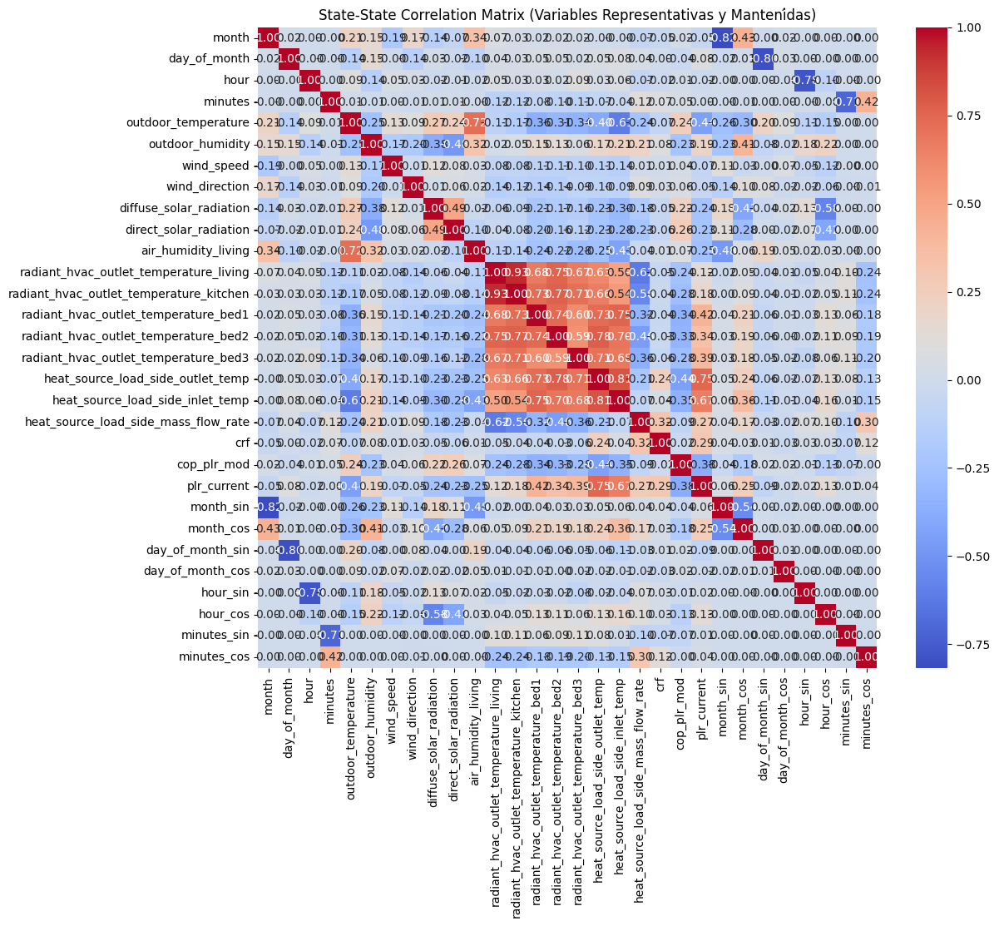

In [52]:
# --------------------------
# Variables representativas elegidas manualmente
# --------------------------
representative_vars = ['outdoor_temperature','air_humidity_living','radiant_hvac_outlet_temperature_livint','plr_current']

# --------------------------
# Descarta todas las variables correlacionadas con las representativas
# --------------------------
discarded_manual = set()

for rep_var in representative_vars:
    if rep_var in state_corr_matrix.columns:
        # Variables con correlación > umbral
        correlated = state_corr_matrix.index[
            (state_corr_matrix[rep_var].abs() > high_corr_threshold) &
            (state_corr_matrix.index != rep_var)
        ].tolist()
        discarded_manual.update(correlated)
        
        # Variables con correlación NaN con la representativa
        nan_correlated = state_corr_matrix.index[
            state_corr_matrix[rep_var].isna()
        ].tolist()
        discarded_manual.update(nan_correlated)

# Las representativas no se descartan
discarded_manual = discarded_manual - set(representative_vars)

# --------------------------
# Crear DataFrame filtrado
# --------------------------
final_vars_manual = [v for v in state_only_df.columns if v not in discarded_manual]
filtered_state_df_manual = state_only_df[final_vars_manual]

print("\nVariables representativas elegidas:")
print(representative_vars)
print("\nVariables descartadas por correlación o NaN con las representativas:")
print(sorted(discarded_manual))
print("\nVariables finales:")
print(sorted(final_vars_manual))

# --------------------------
# Heatmap final con variables filtradas
# --------------------------
if not filtered_state_df_manual.empty:
    plt.figure(figsize=(12,10))
    sns.heatmap(filtered_state_df_manual.corr(), cmap='coolwarm', annot=True, fmt=".2f")
    plt.title("State-State Correlation Matrix (Variables Representativas y Mantenídas)")
    plt.show()
else:
    print("No quedan variables después del filtrado.")

### Variables finales

['minutes', 'wind_speed', 'htg_setpoint_living', 'htg_setpoint_kitchen', 'htg_setpoint_bed1', 'htg_setpoint_bed2', 'htg_setpoint_bed3', 'radiant_hvac_outlet_temperature_living', 'day_of_month_cos', 'minutes_sin', 'minutes_cos']
{'air_humidity_kitchen', 'cop_temp_mod', 'htg_setpoint_bed1', 'htg_setpoint_kitchen', 'air_humidity_bed1', 'htg_setpoint_living', 'htg_setpoint_bed3', 'htg_setpoint_bed2', 'heat_cap_mod', 'air_humidity_bed3', 'heat_source_load_side_heat_transfer_rate', 'air_humidity_bed2'}

Variables finales mantenidas después de ambos filtrados:
['air_humidity_living', 'cop_plr_mod', 'crf', 'day_of_month', 'day_of_month_sin', 'diffuse_solar_radiation', 'direct_solar_radiation', 'heat_source_load_side_inlet_temp', 'heat_source_load_side_mass_flow_rate', 'heat_source_load_side_outlet_temp', 'hour', 'hour_cos', 'hour_sin', 'month', 'month_cos', 'month_sin', 'outdoor_humidity', 'outdoor_temperature', 'plr_current', 'radiant_hvac_outlet_temperature_bed1', 'radiant_hvac_outlet_temper

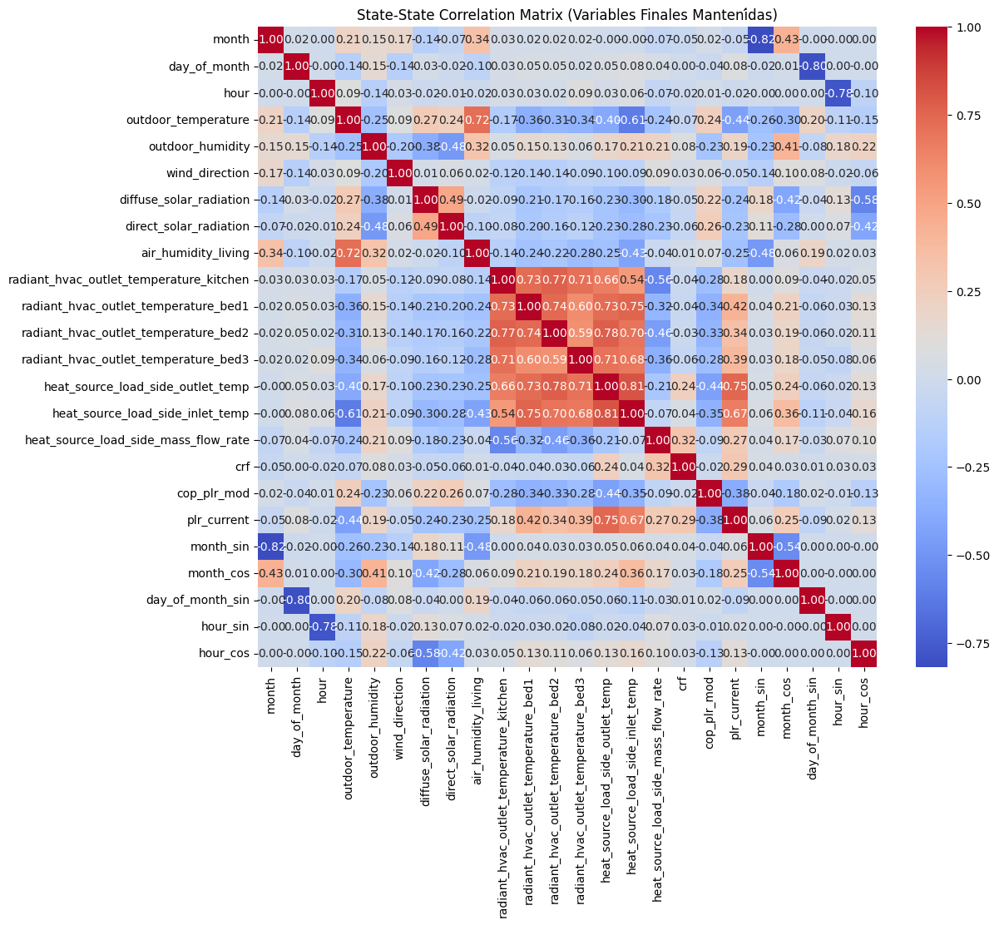

In [81]:
# --------------------------
# Combinar variables descartadas de ambas etapas
# --------------------------
# Variables descartadas por correlación con targets
discarded_corr_threshold = set(discarded_vars)  # de la celda 1
print(discarded_vars)

# Variables descartadas por correlación entre representativas
discarded_manual_set = set(discarded_manual)    # de la celda 2
print(discarded_manual)

# Unión de todas las variables descartadas
all_discarded = discarded_corr_threshold.union(discarded_manual_set)

# --------------------------
# Crear DataFrame final con variables mantenidas
# --------------------------
final_vars = [v for v in state_only_df.columns if v not in all_discarded]
final_state_df = state_only_df[final_vars]

print("\nVariables finales mantenidas después de ambos filtrados:")
print(sorted(final_vars))

# --------------------------
# Heatmap final de las variables mantenidas
# --------------------------
if not final_state_df.empty:
    plt.figure(figsize=(12,10))
    sns.heatmap(final_state_df.corr(), cmap='coolwarm', annot=True, fmt=".2f")
    plt.title("State-State Correlation Matrix (Variables Finales Mantenídas)")
    plt.show()
else:
    print("No quedan variables después de aplicar ambos filtros.")

## Time correlations
- Las correlacions action-target y action-state no las estudiamos directamente porque llevan un retardo en principio desconocido

=== AUTOCORRELACIONES DE STATE VARIABLES ===


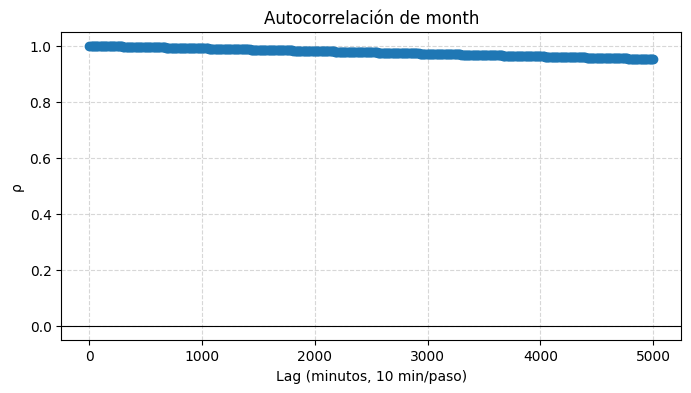

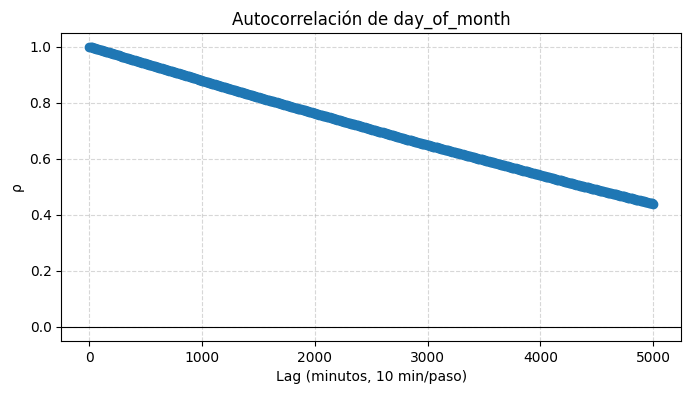

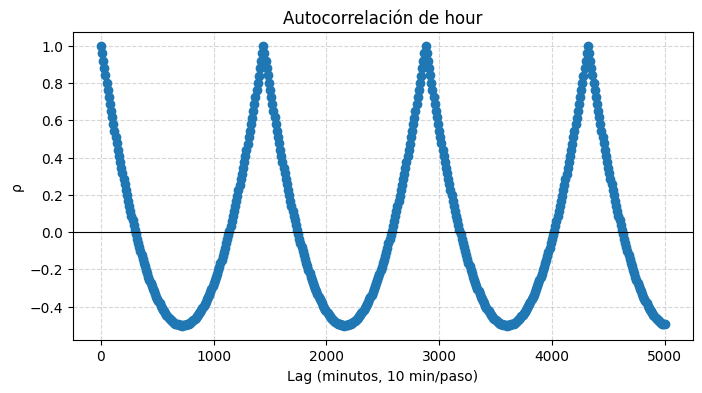

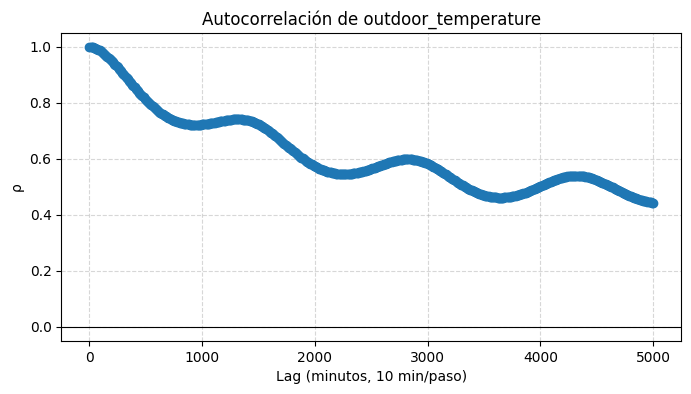

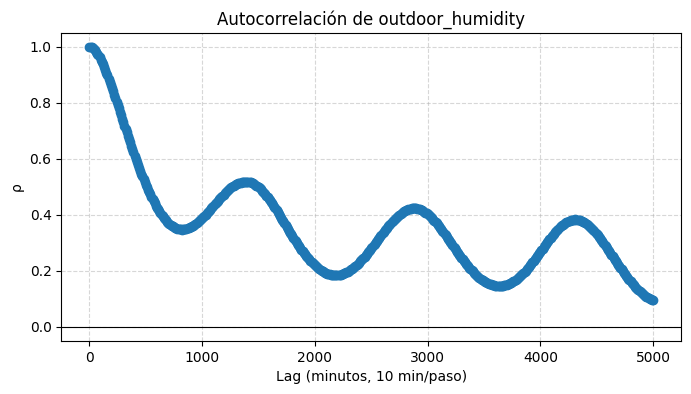

...

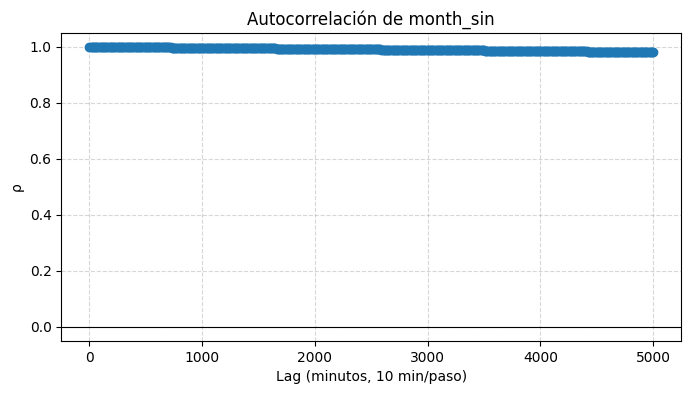

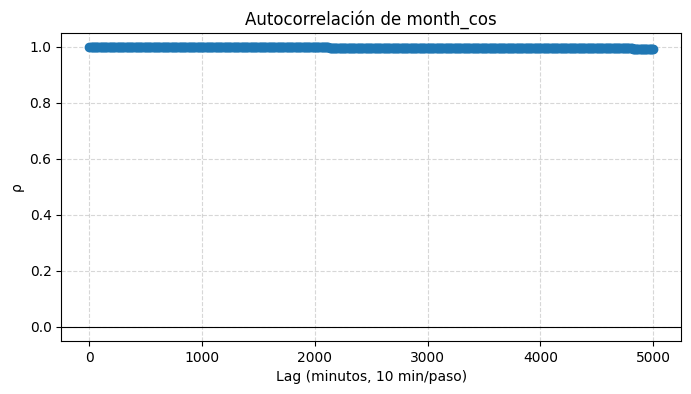

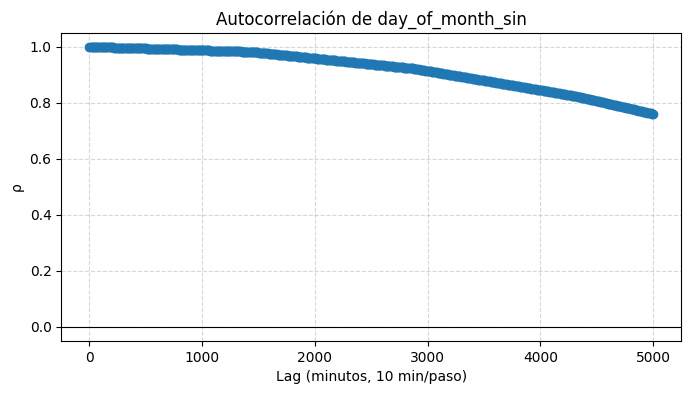

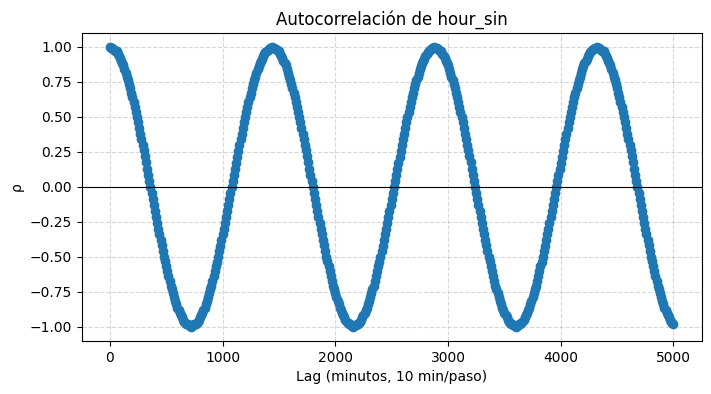

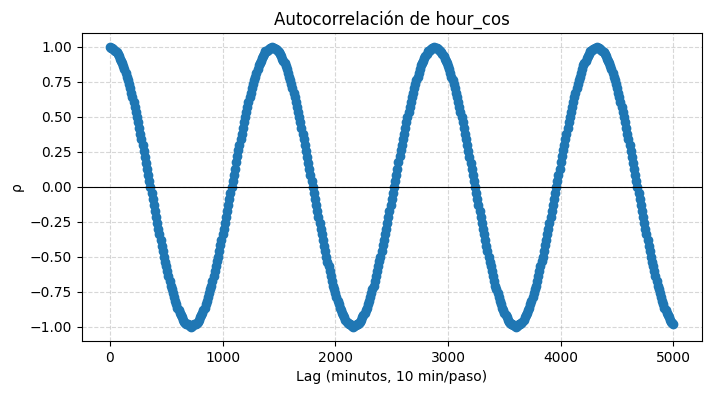

=== AUTOCORRELACIONES DE TARGET VARIABLES ===


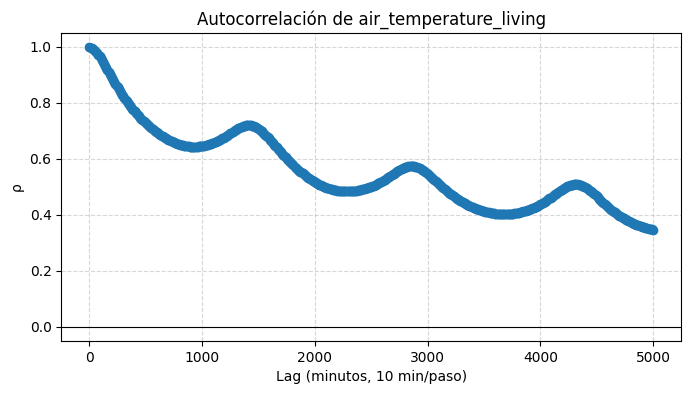

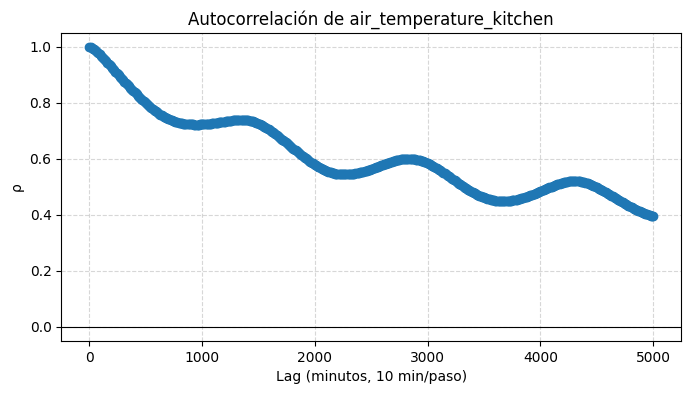

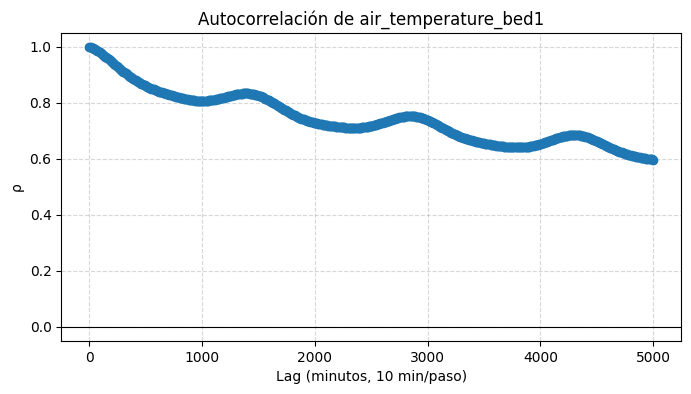

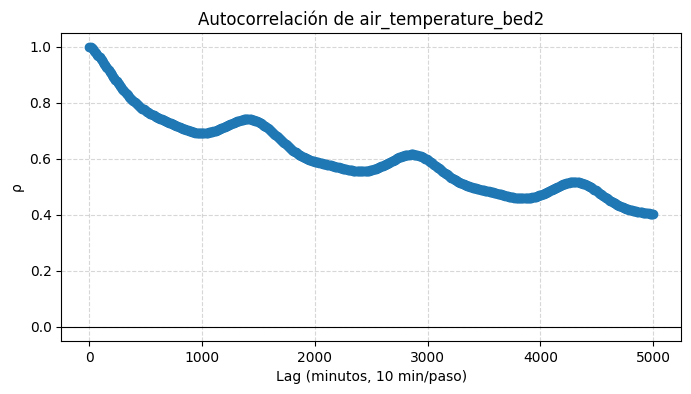

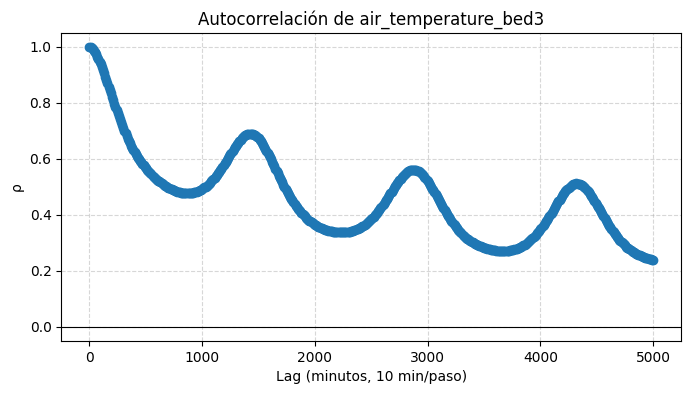

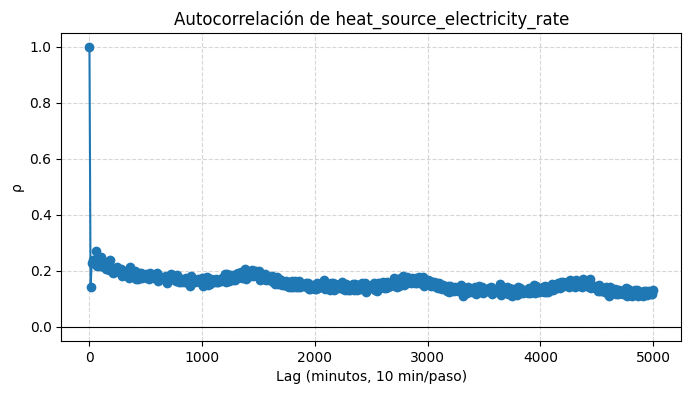

=== AUTOCORRELACIONES DE ACTION VARIABLES ===


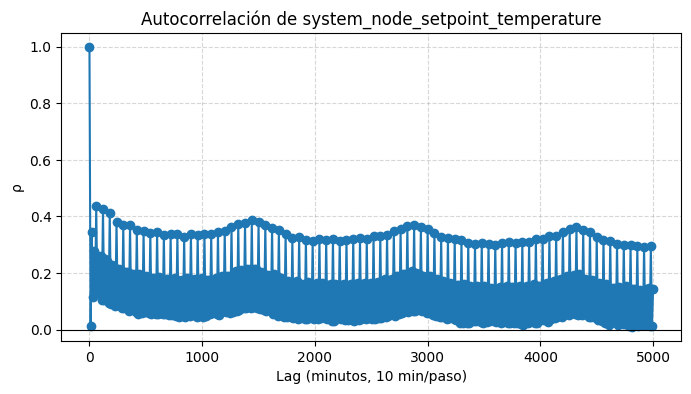

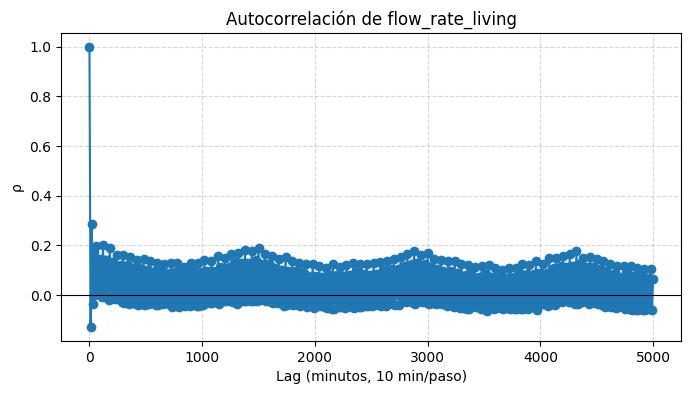

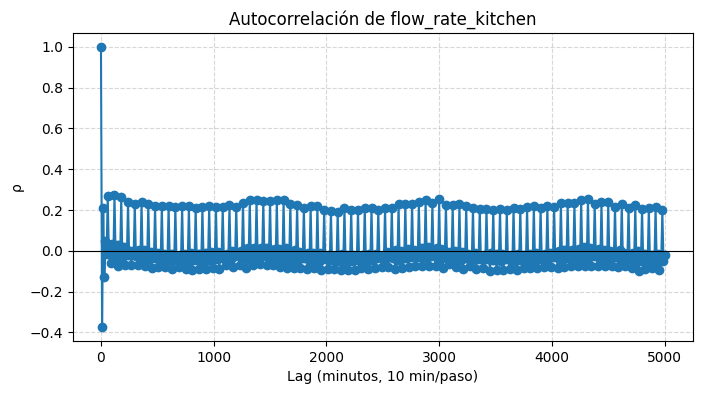

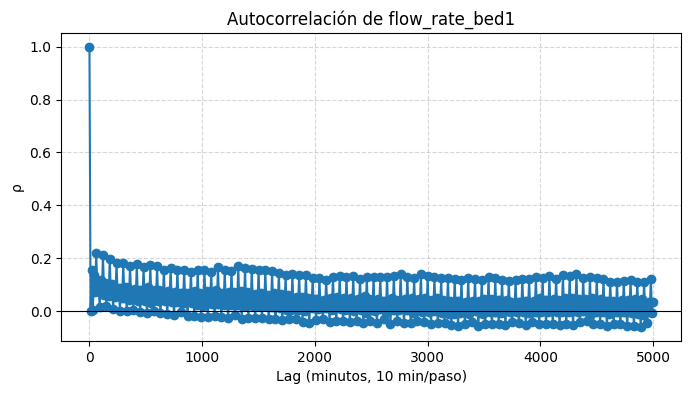

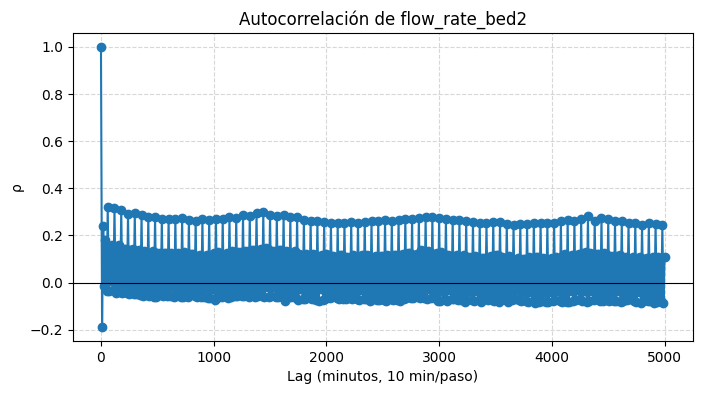

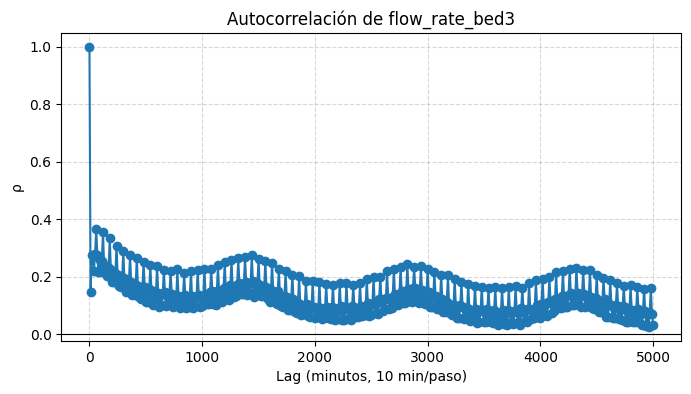

=== CORRELACIONES CRUZADAS: STATE ↔ TARGET ===


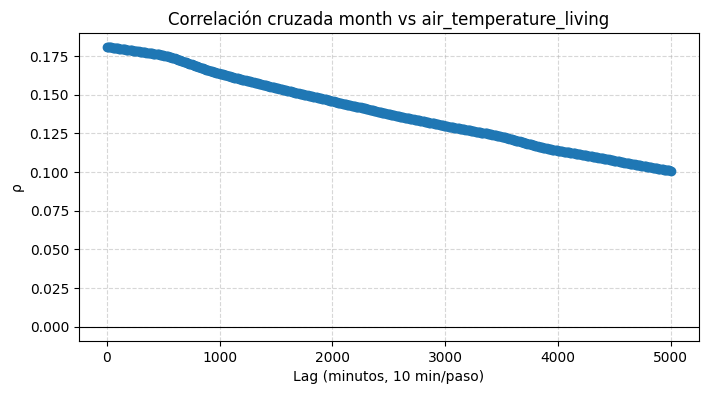

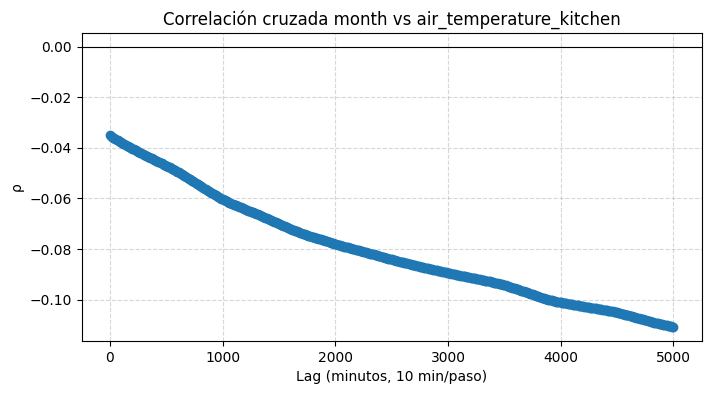

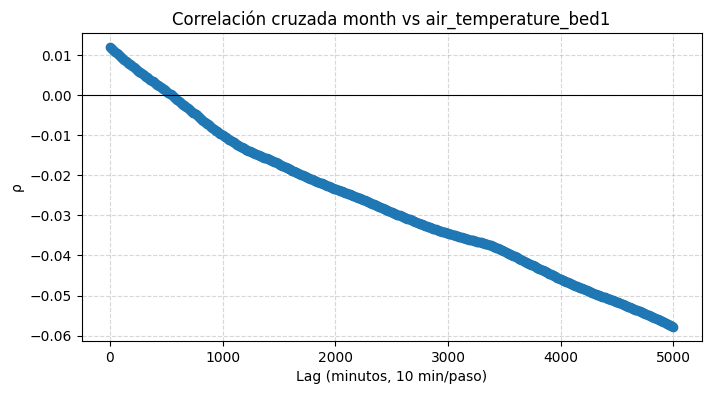

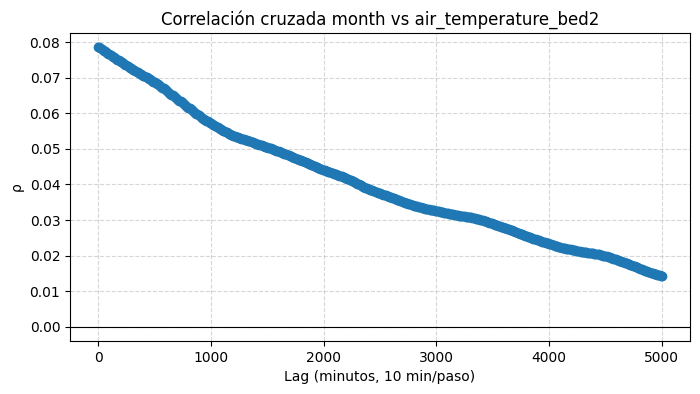

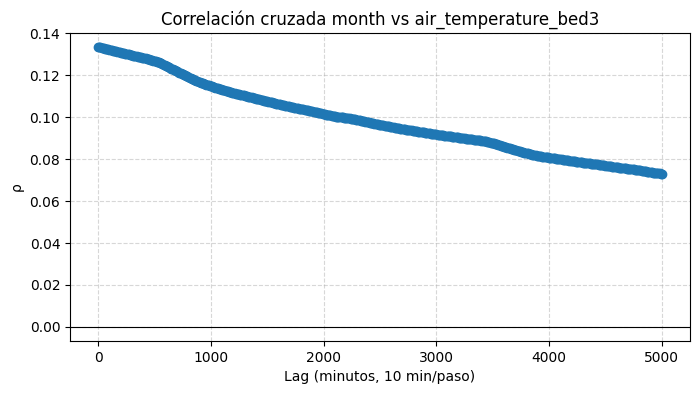

...

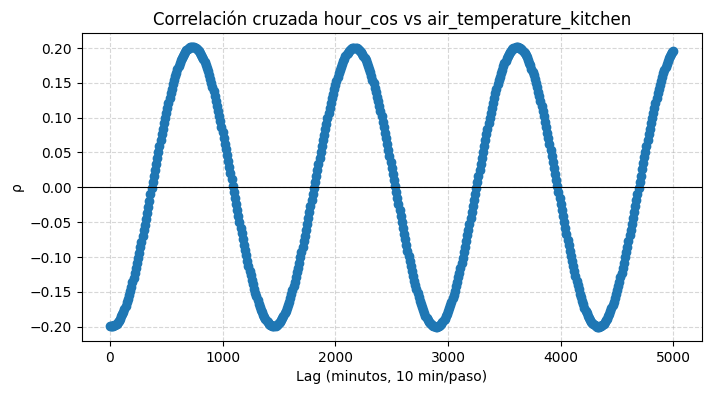

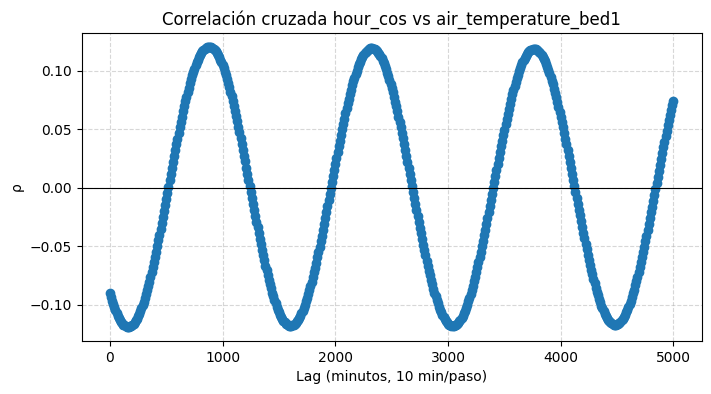

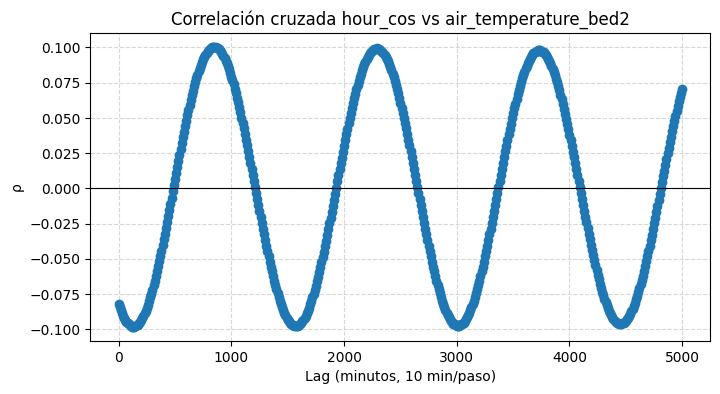

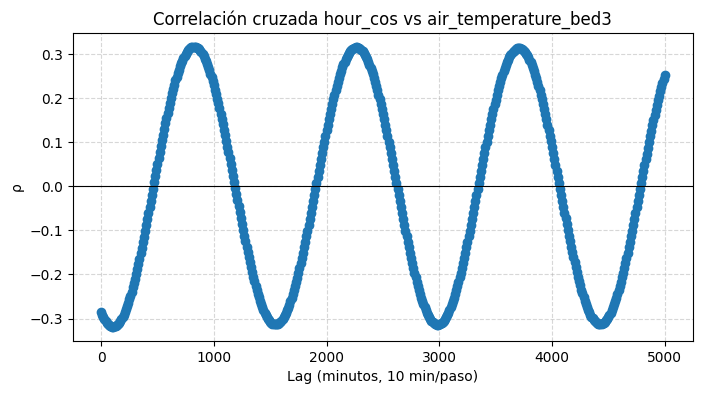

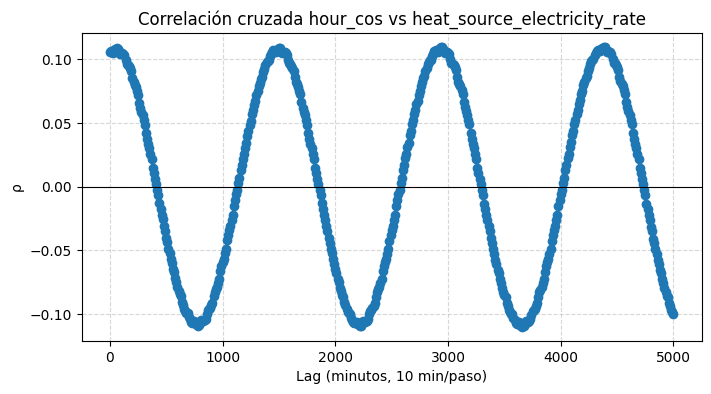

=== CORRELACIONES CRUZADAS: STATE ↔ ACTION ===


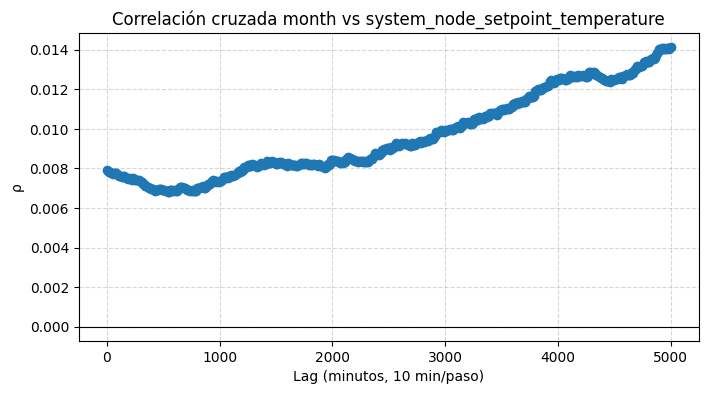

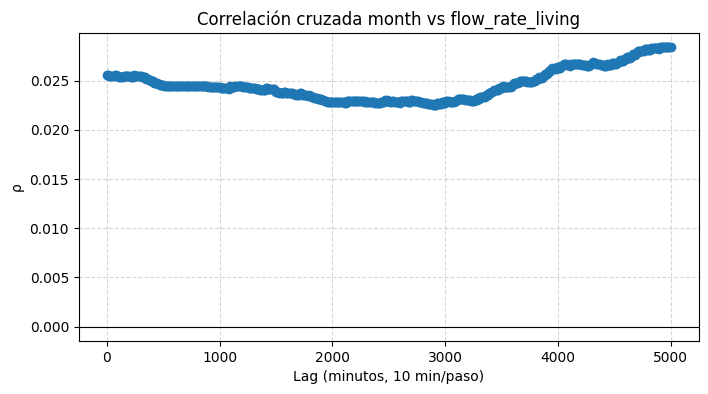

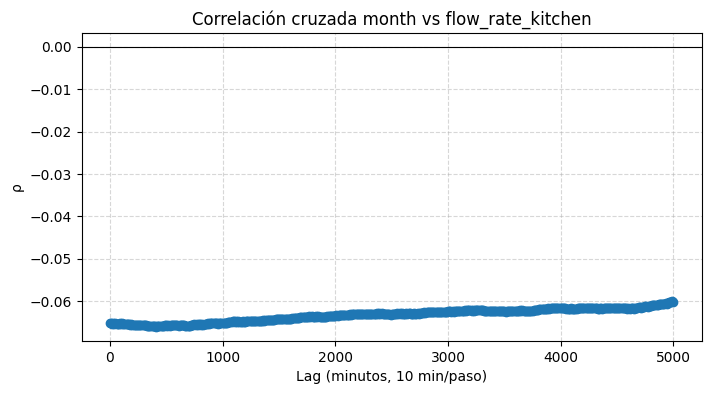

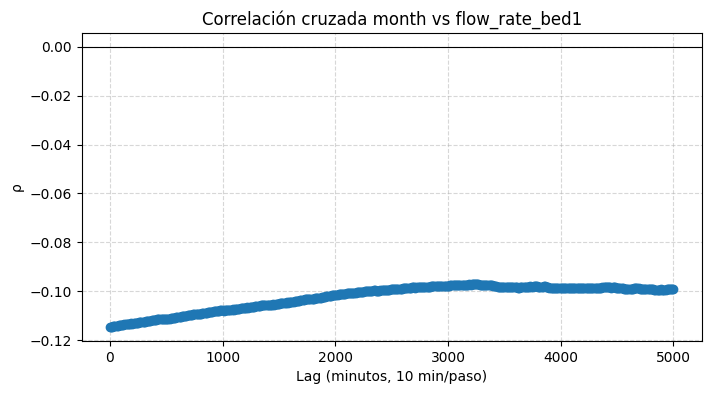

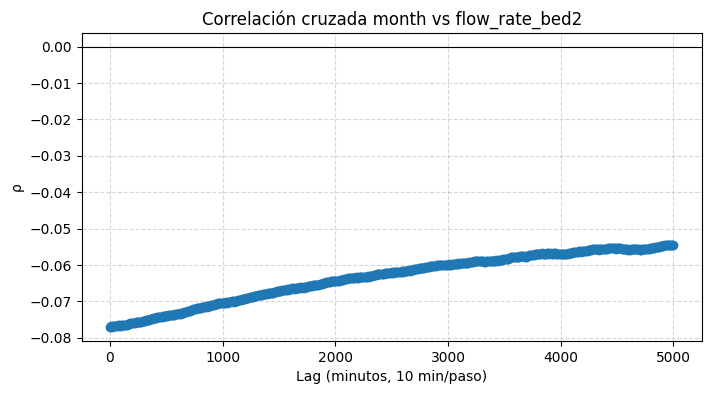

...

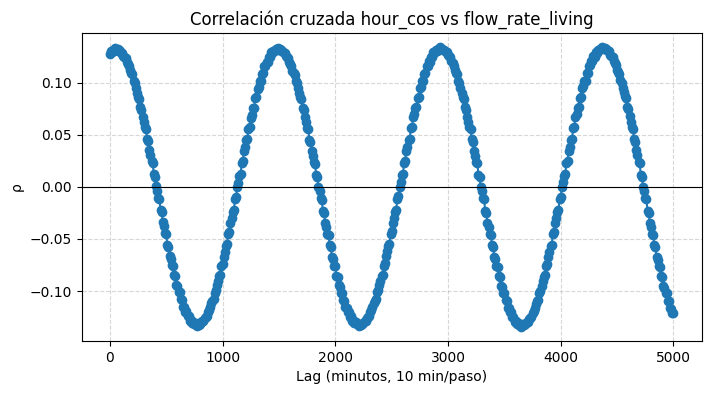

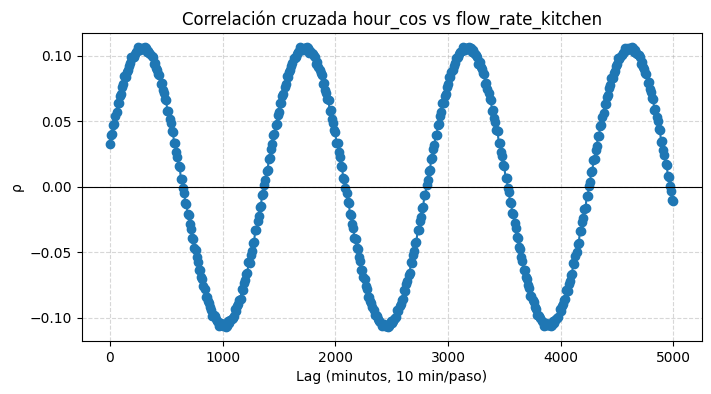

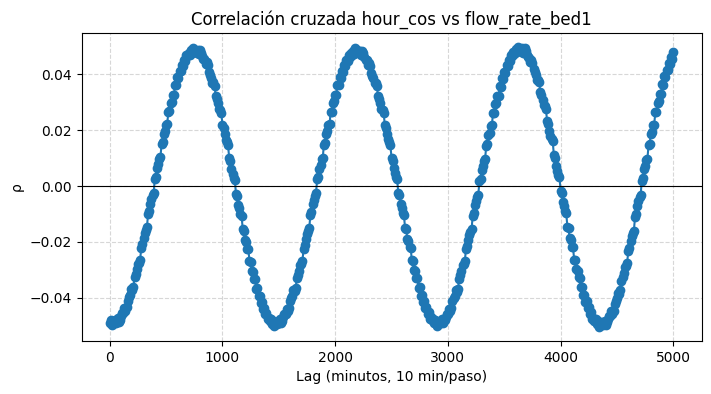

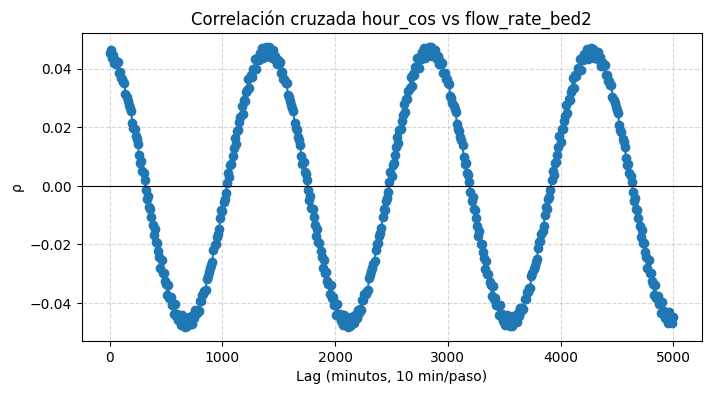

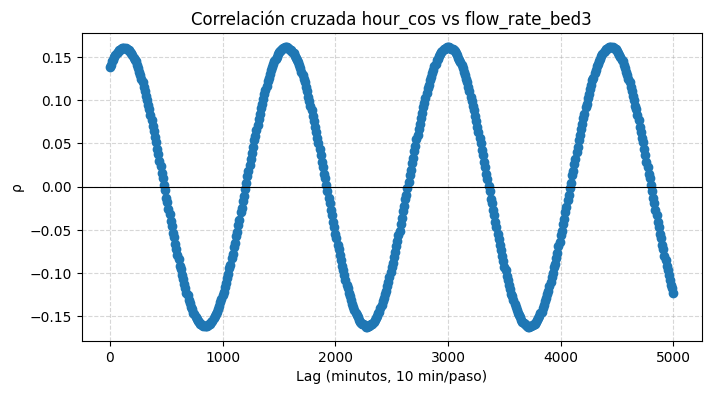

=== CORRELACIONES CRUZADAS: ACTION ↔ TARGET ===


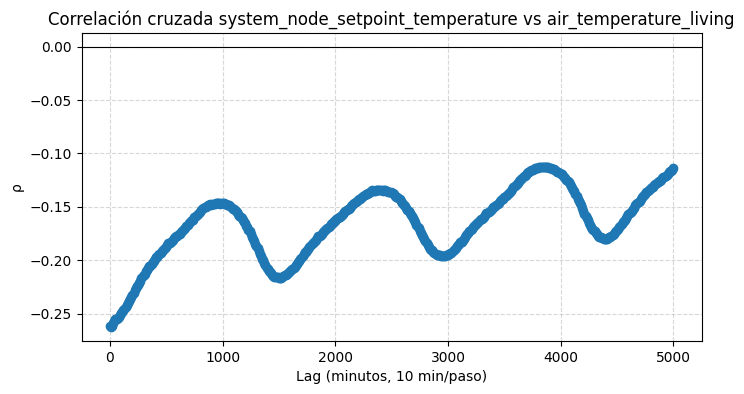

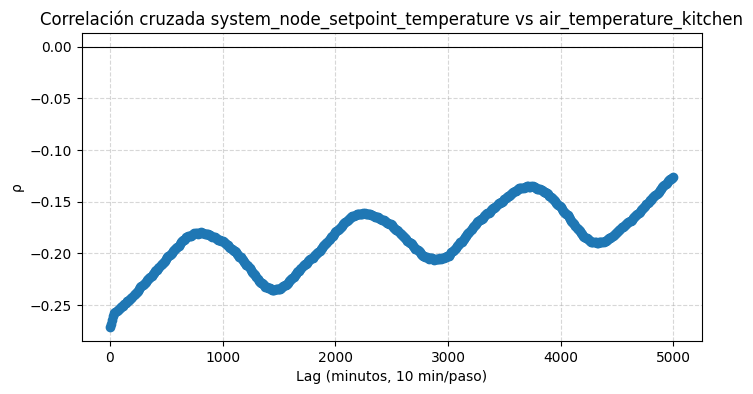

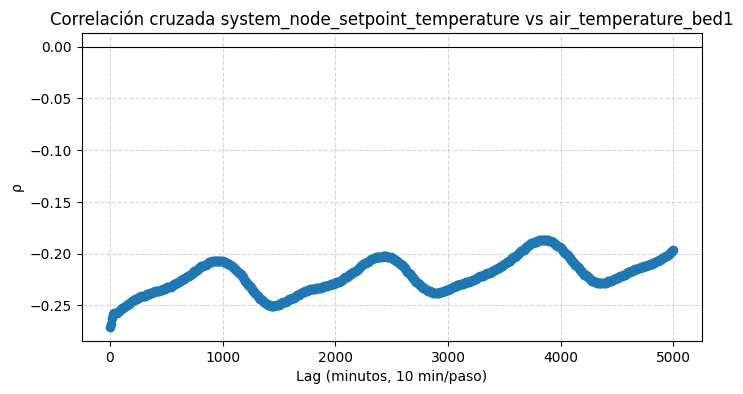

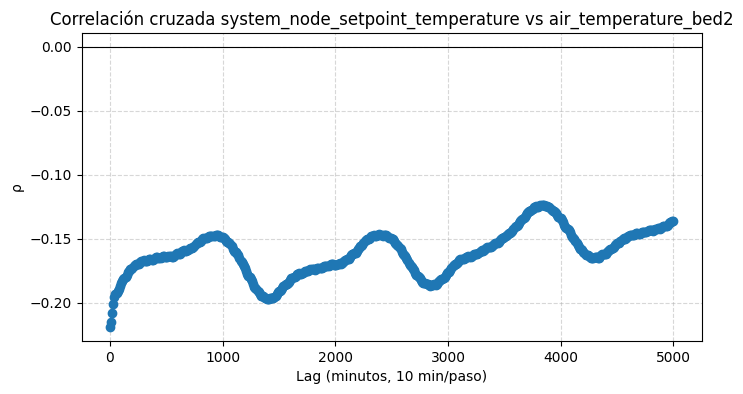

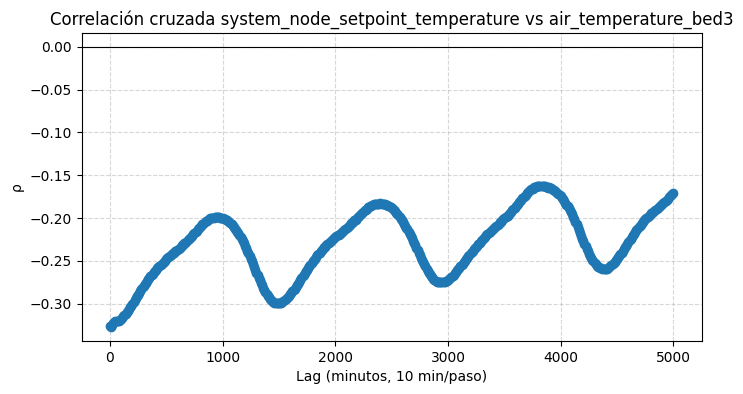

...

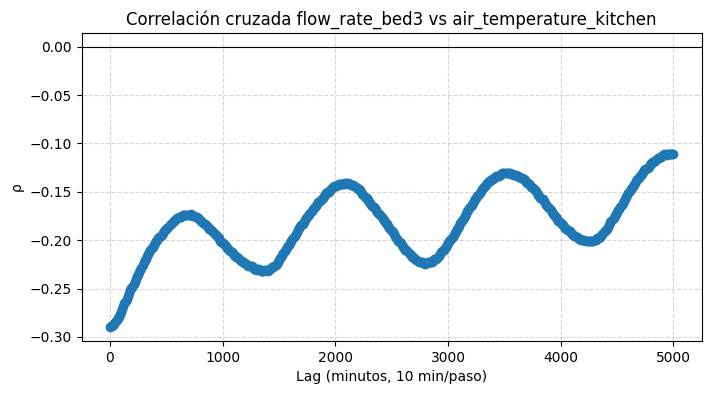

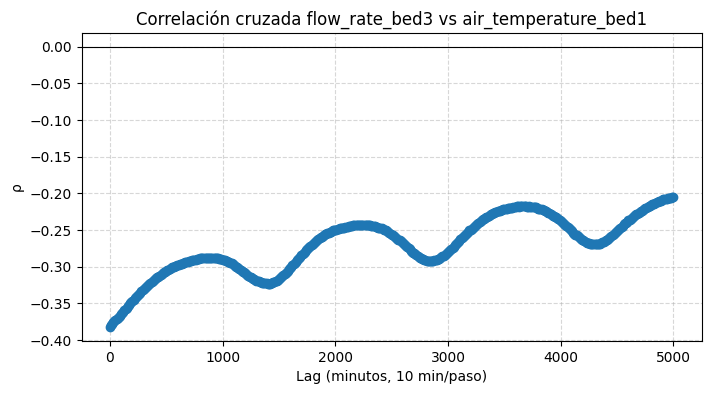

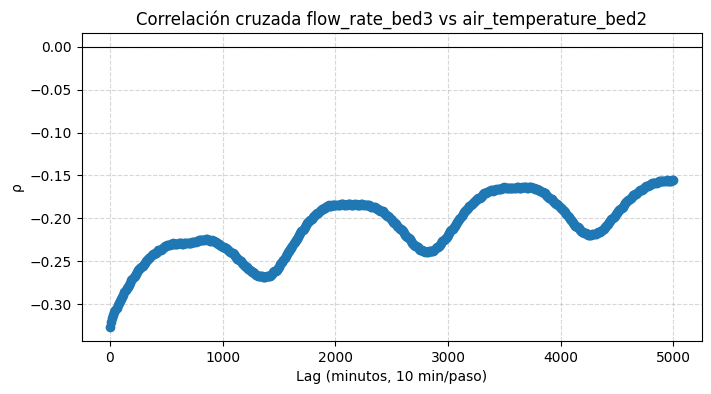

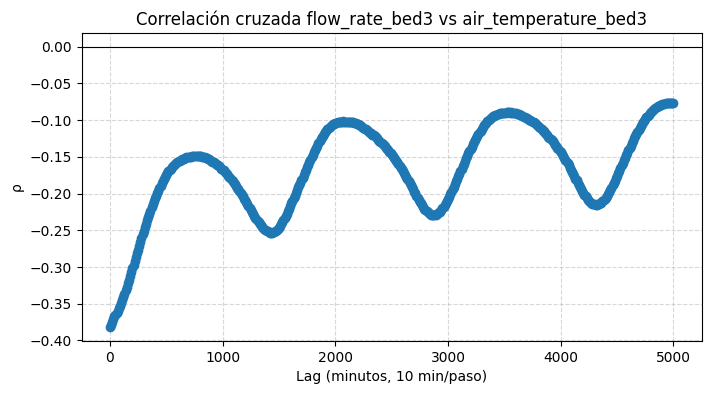

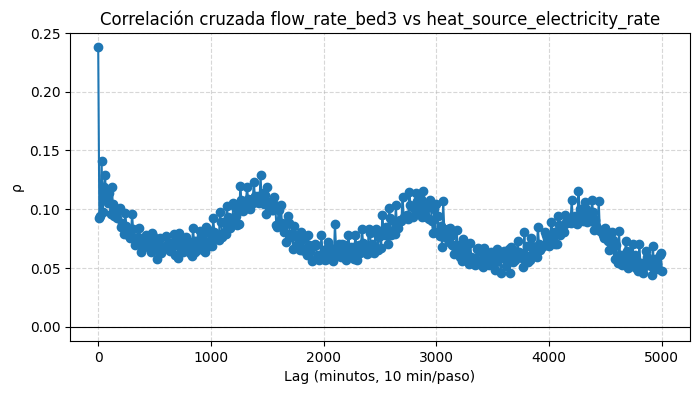

In [57]:
from itertools import combinations, product

# --------------------------
# Función de correlación temporal
# --------------------------
def time_correlation(A, B, max_lag, normalize=True):
    """
    Calcula la función de correlación temporal discreta entre dos series A y B.
    """
    N = len(A)
    corr = []
    for k in range(max_lag + 1):
        vals = A[:N - k] * B[k:N]
        corr.append(np.mean(vals))
    corr = np.array(corr)

    if normalize:
        norm_factor = np.sqrt(np.mean(A**2) * np.mean(B**2))
        if norm_factor != 0:
            corr = corr / norm_factor
    return corr

# --------------------------
# Función de graficado genérica
# --------------------------
def plot_time_correlation(A, B, nameA, nameB, max_lag=100, dt_minutes=10):
    corr = time_correlation(A, B, max_lag)
    lags = np.arange(max_lag + 1) * dt_minutes
    plt.figure(figsize=(8,4))
    plt.plot(lags, corr, marker="o")
    plt.axhline(0, color="black", lw=0.8)
    if nameA == nameB:
        plt.title(f"Autocorrelación de {nameA}")
    else:
        plt.title(f"Correlación cruzada {nameA} vs {nameB}")
    plt.xlabel(f"Lag (minutos, {dt_minutes} min/paso)")
    plt.ylabel("ρ")
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.show()

# --------------------------
# DataFrames a usar
# --------------------------
# Asegúrate de tener estos ya definidos en memoria:
# final_state_df  → variables de estado mantenidas
# target_df       → variables target
# action_df       → variables de acción

# --------------------------
# 1. Autocorrelaciones de cada grupo
# --------------------------
print("=== AUTOCORRELACIONES DE STATE VARIABLES ===")
for v in final_state_df.columns:
    plot_time_correlation(final_state_df[v].values, final_state_df[v].values, v, v, max_lag=500, dt_minutes=10)

print("=== AUTOCORRELACIONES DE TARGET VARIABLES ===")
for v in target_df.columns:
    plot_time_correlation(target_df[v].values, target_df[v].values, v, v, max_lag=500, dt_minutes=10)

print("=== AUTOCORRELACIONES DE ACTION VARIABLES ===")
for v in action_df.columns:
    plot_time_correlation(action_df[v].values, action_df[v].values, v, v, max_lag=500, dt_minutes=10)

# --------------------------
# 2. Correlaciones cruzadas entre grupos
# --------------------------
print("=== CORRELACIONES CRUZADAS: STATE ↔ TARGET ===")
for s, t in product(final_state_df.columns, target_df.columns):
    plot_time_correlation(final_state_df[s].values, target_df[t].values, s, t, max_lag=500, dt_minutes=10)

print("=== CORRELACIONES CRUZADAS: STATE ↔ ACTION ===")
for s, a in product(final_state_df.columns, action_df.columns):
    plot_time_correlation(final_state_df[s].values, action_df[a].values, s, a, max_lag=500, dt_minutes=10)

print("=== CORRELACIONES CRUZADAS: ACTION ↔ TARGET ===")
for a, t in product(action_df.columns, target_df.columns):
    plot_time_correlation(action_df[a].values, target_df[t].values, a, t, max_lag=500, dt_minutes=10)

Conclusión:
- Cada variable tiene una escala de tiempo.
- Quizás podamos caracterizar la escala de tiempo de cada variable con algún parámetro y agruparlas por grupos para construir modelos de las variables con escala de tiempo similar

In [63]:
# ===========================================
# MÉTODOS DE CARACTERIZACIÓN DE ESCALA TEMPORAL
# ===========================================

from scipy.signal import welch
from scipy.stats import linregress

def time_autocorrelation(x, max_lag=500):
    """Calcula autocorrelación normalizada hasta max_lag."""
    x = x - np.nanmean(x)
    N = len(x)
    corr = np.array([np.nanmean(x[:N-k] * x[k:N]) for k in range(max_lag+1)])
    corr /= np.nanvar(x)
    return corr

def characteristic_time_from_acf(acf, dt_minutes=10, threshold=1/np.e):
    """Tiempo de decaimiento: primer lag donde ACF < threshold."""
    below = np.where(acf < threshold)[0]
    if len(below) == 0:
        return np.nan
    lag_index = below[0]
    return lag_index * dt_minutes  # en minutos

def dominant_period_fft(x, dt_minutes=10):
    """Obtiene el periodo dominante (Fourier) de una serie."""
    x = x - np.nanmean(x)
    N = len(x)
    freqs = np.fft.rfftfreq(N, d=dt_minutes*60)  # en Hz
    fft_vals = np.abs(np.fft.rfft(x))
    if np.all(fft_vals == 0):
        return np.nan
    f_dom = freqs[np.argmax(fft_vals[1:]) + 1]
    if f_dom == 0:
        return np.nan
    period_minutes = 1 / f_dom / 60  # convertir a minutos
    return period_minutes

def increment_variability(x):
    """Varianza relativa de los incrementos."""
    dx = np.diff(x)
    var_dx = np.nanvar(dx)
    var_x = np.nanvar(x)
    if var_x == 0:
        return np.nan
    return var_dx / var_x

def ar1_timescale(x, dt_minutes=10):
    """Ajuste AR(1): x_t = φ x_{t-1} + ε_t → τ = -Δt / ln(φ)."""
    x = np.array(x)
    x1, x2 = x[:-1], x[1:]
    if np.all(np.isnan(x1)) or np.all(np.isnan(x2)):
        return np.nan
    slope, _, _, _, _ = linregress(x1, x2)
    phi = slope
    if phi <= 0 or phi >= 1:
        return np.nan
    tau = -dt_minutes / np.log(phi)
    return tau

# ===========================================
# FUNCIÓN PRINCIPAL
# ===========================================

def compute_time_scales(df, max_lag=500, dt_minutes=10, plot_examples=False):
    """
    Calcula distintas escalas temporales (A-D) para cada variable del DataFrame.
    Devuelve un DataFrame con parámetros característicos.
    """
    results = []

    for col in df.columns:
        x = df[col].dropna().values
        if len(x) < 20:
            continue

        # --- A. ACF decay time ---
        acf = time_autocorrelation(x, max_lag=max_lag)
        tau_acf = characteristic_time_from_acf(acf, dt_minutes)

        # --- B. Dominant period (Fourier) ---
        period_fft = dominant_period_fft(x, dt_minutes)

        # --- C. Increment variability ratio ---
        R = increment_variability(x)

        # --- D. AR(1) estimated time constant ---
        tau_ar1 = ar1_timescale(x, dt_minutes)

        results.append({
            "variable": col,
            "tau_acf_min": tau_acf,
            "tau_ar1_min": tau_ar1,
            "period_fft_min": period_fft,
            "R_var_increments": R
        })

        # Optional plot for diagnostics
        if plot_examples:
            lags = np.arange(len(acf)) * dt_minutes
            plt.figure(figsize=(6,3))
            plt.plot(lags, acf, 'o-', label=f"ACF {col}")
            plt.axhline(1/np.e, color='r', linestyle='--', label='1/e')
            plt.xlabel("Lag (min)")
            plt.ylabel("Autocorr")
            plt.title(f"Autocorrelación - {col}")
            plt.legend()
            plt.tight_layout()
            plt.show()

    return pd.DataFrame(results)


In [73]:
# 1️⃣ Definir las variables temporales que quieres excluir
temporal_vars = [
    "month", "day_of_month", "hour", "minutes",
    "month_sin", "month_cos",
    "day_of_month_sin", "day_of_month_cos",
    "hour_sin", "hour_cos",
    "minutes_sin", "minutes_cos"
]

external_vars = [
    "outdoor_temperature",
    "outdoor_humidity",
    "wind_speed",
    "wind_direction",
    "diffuse_solar_radiation",
    "direct_solar_radiation",
    "htg_setpoint_living",
    "htg_setpoint_kitchen",
    "htg_setpoint_bed1",
    "htg_setpoint_bed2",
    "htg_setpoint_bed3"
]


# 2️⃣ Unir todos los DataFrames por columnas (eje=1)
final_df = pd.concat([final_state_df, action_df, target_df], axis=1)

print(f"Shape final_df: {final_df.shape}")
print(f"Columnas totales: {len(final_df.columns)}")

# 3️⃣ Detectar variables constantes
constant_cols = [c for c in final_df.columns if final_df[c].nunique() <= 1]
print(f"Variables constantes ({len(constant_cols)}): {constant_cols}")

# 4️⃣ Unir las listas de columnas a excluir
exclude_cols = list(set(constant_cols + temporal_vars + external_vars))
#exclude_cols = list(set(constant_cols + temporal_vars))
exclude_cols = [c for c in exclude_cols if c in final_df.columns]  # asegurar que existan
print(f"Columnas excluidas ({len(exclude_cols)}): {exclude_cols}")

#  Crear DataFrame solo con variables relevantes
final_df_relevants = final_df.drop(columns=exclude_cols)
print(f"Variables utilizadas ({len(final_df_relevants.columns)}): {list(final_df_relevants.columns)}")

# 5️⃣ Ejecutar el análisis solo con las variables relevantes
dt_minutes = 10
scales_df = compute_time_scales(final_df_relevants, max_lag=2000, dt_minutes=dt_minutes, plot_examples=False)

# 6️⃣ Ordenar y visualizar resultados
scales_df_sorted = scales_df.sort_values("tau_acf_min")
display(scales_df_sorted.head(35))

Shape final_df: (30519, 36)
Columnas totales: 36
Variables constantes (0): []
Columnas excluidas (13): ['month_cos', 'wind_direction', 'month', 'outdoor_temperature', 'day_of_month', 'day_of_month_sin', 'hour_cos', 'hour_sin', 'direct_solar_radiation', 'diffuse_solar_radiation', 'month_sin', 'outdoor_humidity', 'hour']
Variables utilizadas (23): ['air_humidity_living', 'radiant_hvac_outlet_temperature_kitchen', 'radiant_hvac_outlet_temperature_bed1', 'radiant_hvac_outlet_temperature_bed2', 'radiant_hvac_outlet_temperature_bed3', 'heat_source_load_side_outlet_temp', 'heat_source_load_side_inlet_temp', 'heat_source_load_side_mass_flow_rate', 'crf', 'cop_plr_mod', 'plr_current', 'system_node_setpoint_temperature', 'flow_rate_living', 'flow_rate_kitchen', 'flow_rate_bed1', 'flow_rate_bed2', 'flow_rate_bed3', 'air_temperature_living', 'air_temperature_kitchen', 'air_temperature_bed1', 'air_temperature_bed2', 'air_temperature_bed3', 'heat_source_electricity_rate']


,variable,tau_acf_min,tau_ar1_min,period_fft_min,R_var_increments
1,radiant_hvac_outlet_temperature_kitchen,10,NaN,20.000655,2.267123
2,radiant_hvac_outlet_temperature_bed1,10,4.573719,305190.000000,1.775390
3,radiant_hvac_outlet_temperature_bed2,10,NaN,20.000655,2.008993
4,radiant_hvac_outlet_temperature_bed3,10,3.080451,305190.000000,1.922199
7,heat_source_load_side_mass_flow_rate,10,NaN,20.000655,2.425179
5,heat_source_load_side_outlet_temp,10,3.653835,305190.000000,1.869975
9,cop_plr_mod,10,5.460011,305190.000000,1.679651
8,crf,10,NaN,30.000000,2.032145
12,flow_rate_living,10,NaN,20.000655,2.256506
13,flow_rate_kitchen,10,NaN,30.000000,2.744893


- NaN en tau_ar1_min indica serie muy ruidosa y componentes oscilatorias.

In [74]:
def ar1_phi(x):
    x = np.array(x)
    x1, x2 = x[:-1], x[1:]
    if np.std(x1) == 0:
        return np.nan
    from scipy.stats import linregress
    phi = linregress(x1, x2).slope
    return phi

phis = {col: ar1_phi(final_df_relevants[col].values) for col in final_df_relevants.columns}
pd.Series(phis).sort_values()

# Así verás:

# Si ϕ ≈ 1 → variable con tendencia muy persistente.

#    Si ϕ < 0 → variable oscilatoria.

#    Si ϕ es NaN → serie casi constante o no regresionable.


flow_rate_kitchen                         -0.372441
heat_source_load_side_mass_flow_rate      -0.212621
flow_rate_bed2                            -0.186792
radiant_hvac_outlet_temperature_kitchen   -0.133532
flow_rate_living                          -0.128224
crf                                       -0.016042
radiant_hvac_outlet_temperature_bed2      -0.004477
flow_rate_bed1                            -0.000612
system_node_setpoint_temperature           0.013312
radiant_hvac_outlet_temperature_bed3       0.038919
heat_source_load_side_outlet_temp          0.064774
radiant_hvac_outlet_temperature_bed1       0.112320
heat_source_electricity_rate               0.140594
flow_rate_bed3                             0.146479
plr_current                                0.152778
cop_plr_mod                                0.160173
heat_source_load_side_inlet_temp           0.630505
air_temperature_living                     0.996596
air_temperature_bed3                       0.997408
air_temperat

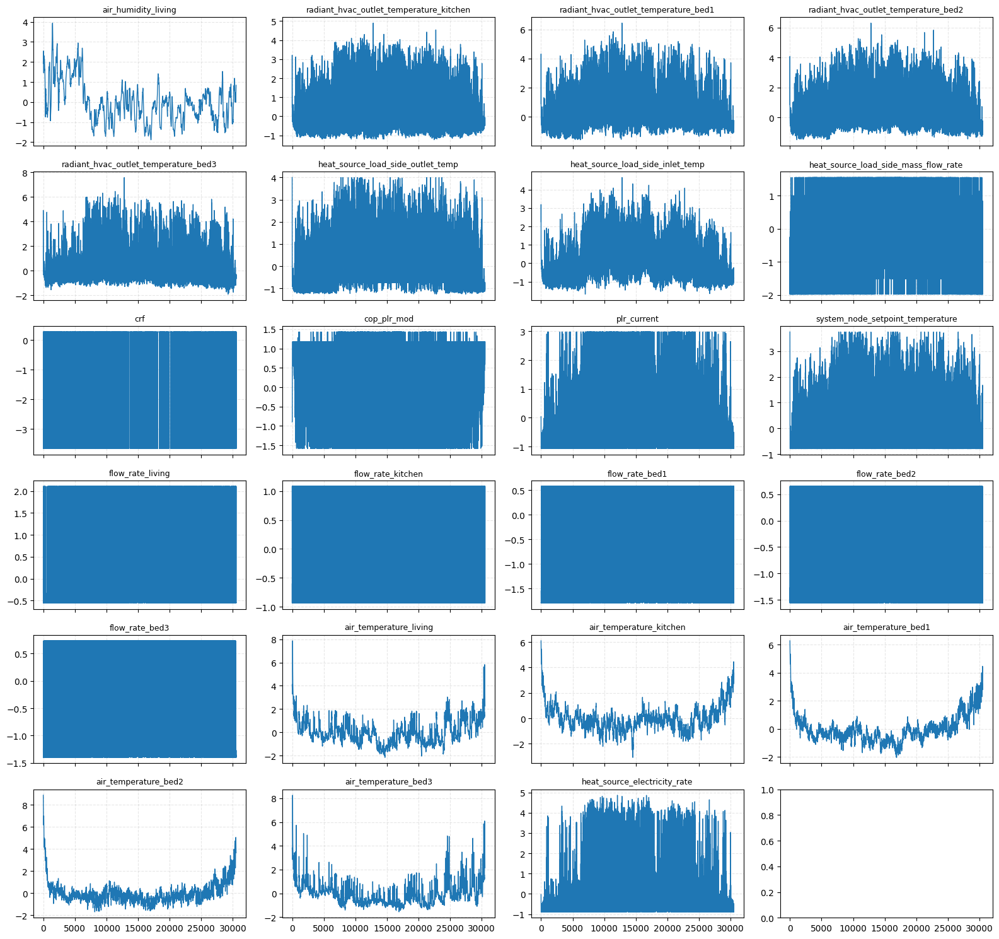

In [75]:
import math

cols = final_df_relevants.columns
n = len(cols)
ncols = 4
nrows = math.ceil(n / ncols)

fig, axes = plt.subplots(nrows, ncols, figsize=(16, nrows*2.5), sharex=True)
axes = axes.flatten()

for i, c in enumerate(cols):
    axes[i].plot(final_df_relevants.index, final_df_relevants[c], lw=1)
    axes[i].set_title(c, fontsize=9)
    axes[i].grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

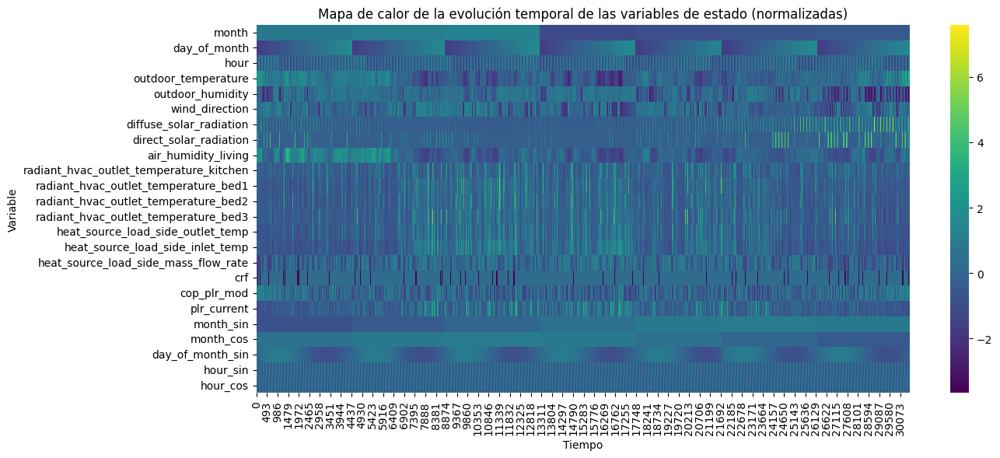

In [76]:
import seaborn as sns

plt.figure(figsize=(14, 6))
sns.heatmap(final_state_df.T, cmap="viridis", cbar=True)
plt.title("Mapa de calor de la evolución temporal de las variables de estado (normalizadas)")
plt.xlabel("Tiempo")
plt.ylabel("Variable")
plt.tight_layout()
plt.show()

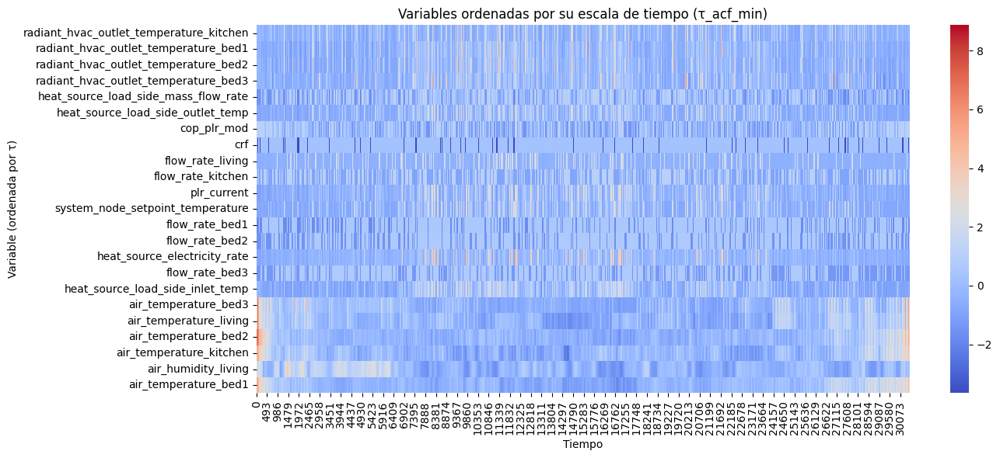

In [80]:
ordered_vars = scales_df_sorted.sort_values("tau_acf_min")["variable"]
ordered_df = final_df_relevants[ordered_vars]

plt.figure(figsize=(14, 6))
sns.heatmap(ordered_df.T, cmap="coolwarm", cbar=True)
plt.title("Variables ordenadas por su escala de tiempo (τ_acf_min)")
plt.xlabel("Tiempo")
plt.ylabel("Variable (ordenada por τ)")
plt.tight_layout()
plt.show()

## Impacto de state variables en target variables

In [84]:
def cross_correlation_with_lags(df_state, df_target, max_lag=2000):
    """
    Calcula la correlación cruzada entre cada variable de estado y cada variable target
    para una serie de lags positivos (en pasos de tiempo del dataset).
    """
    results = []
    for s in df_state.columns:
        a = df_state[s].values
        for t in df_target.columns:
            b = df_target[t].values
            for lag in range(1, max_lag + 1):
                corr = np.corrcoef(a[:-lag], b[lag:])[0, 1]
                results.append((s, t, lag, corr))
    return pd.DataFrame(results, columns=["state_var", "target_var", "lag", "corr"])


# 2️⃣ Ejecutar el análisis
cross_corr_df = cross_correlation_with_lags(
    final_state_df,
    target_df,
    max_lag=2000
)

# 3️⃣ Mostrar resumen
print(f"Variables de estado analizadas: {len(final_state_df.columns)}")
print(f"Variables objetivo: {len(target_df.columns)}")
print(f"Total de pares analizados: {len(cross_corr_df)}")

# Vista previa
cross_corr_df.head()

Variables de estado analizadas: 24
Variables objetivo: 6
Total de pares analizados: 288000


,state_var,target_var,lag,corr
0,month,air_temperature_living,1,0.180977
1,month,air_temperature_living,2,0.180906
2,month,air_temperature_living,3,0.180835
3,month,air_temperature_living,4,0.180763
4,month,air_temperature_living,5,0.180691


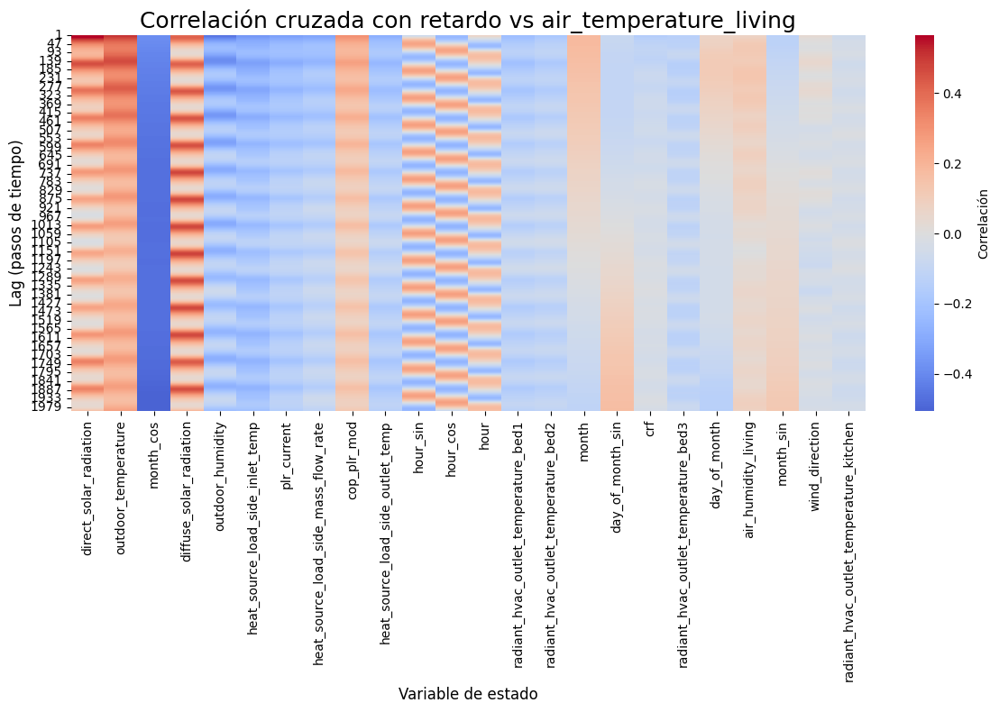

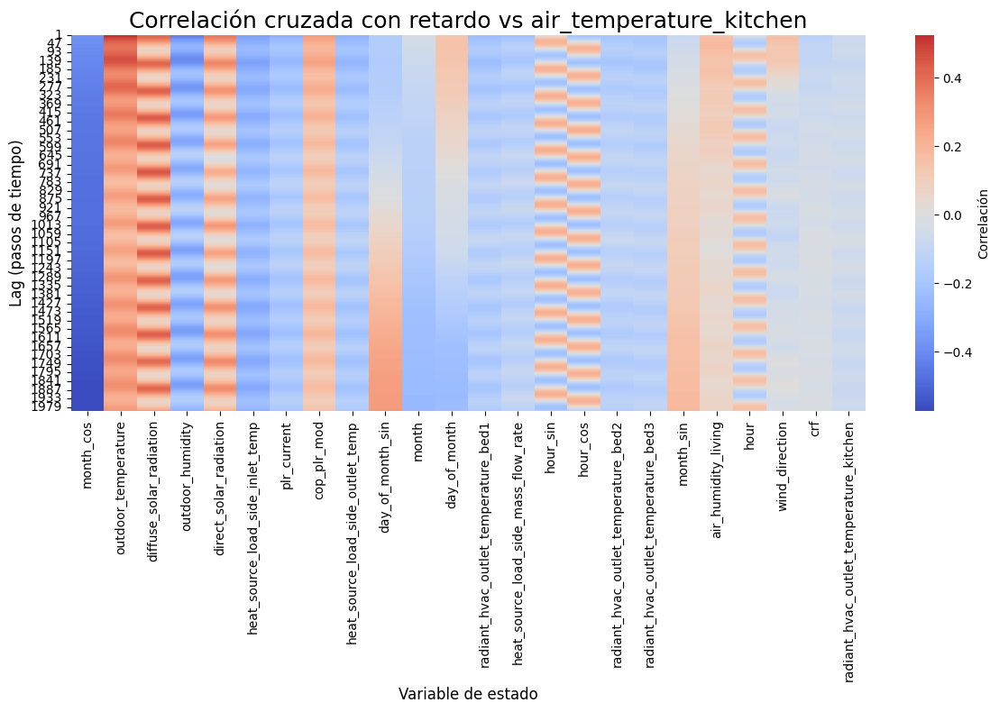

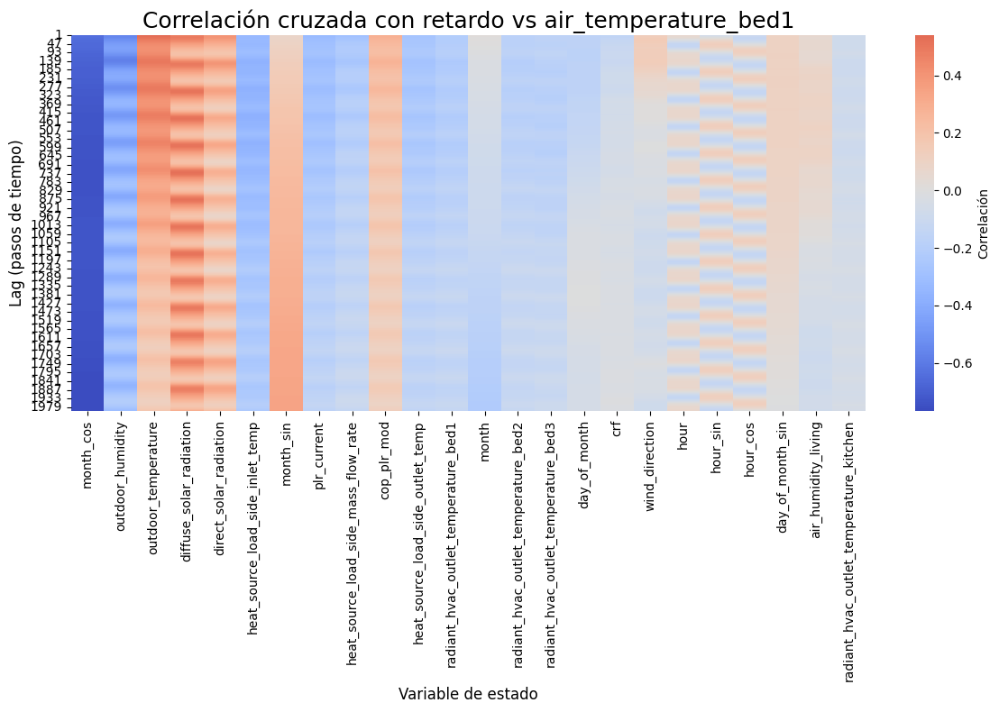

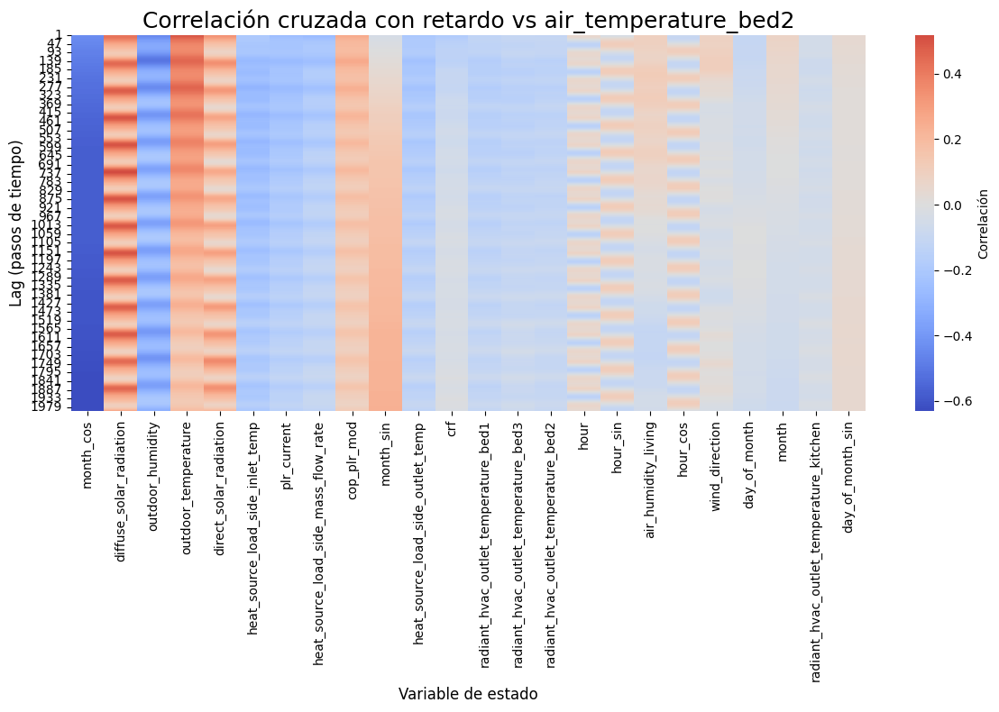

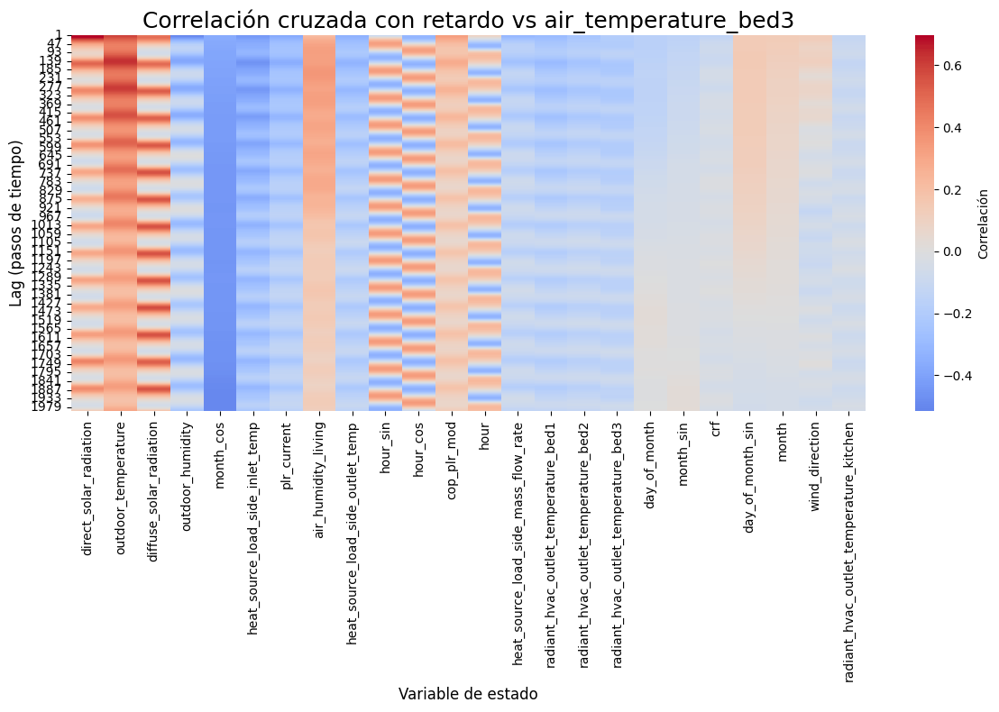

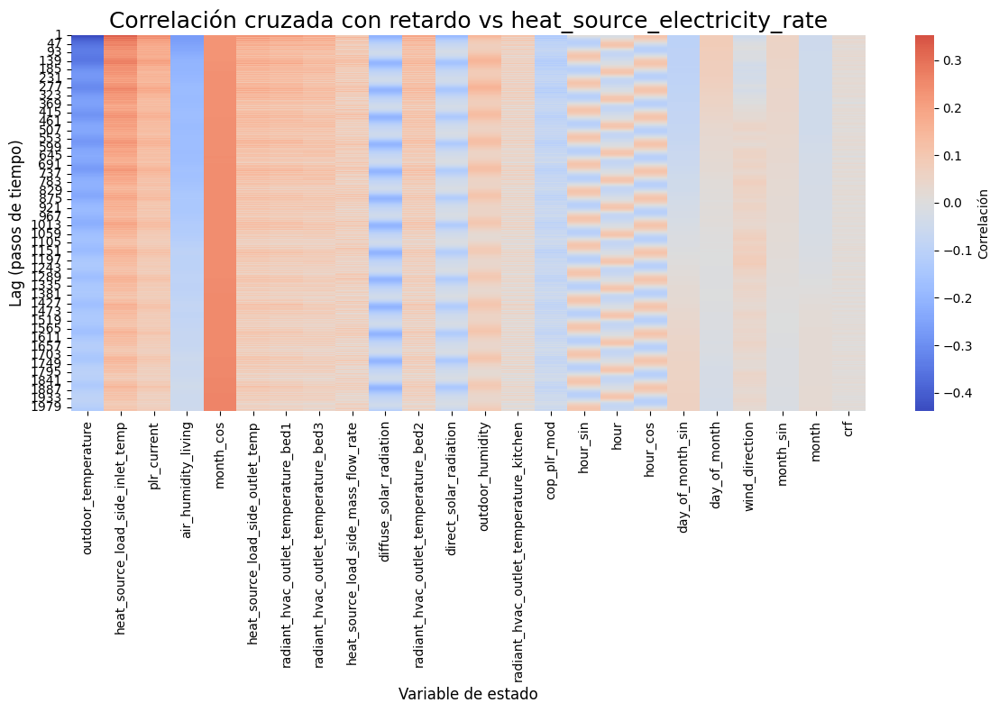

In [86]:
# =======================================
# HEATMAPS DE CORRELACIÓN CRUZADA (STATE → TARGET)
# =======================================

for target in target_df.columns:
    subset = cross_corr_df[cross_corr_df["target_var"] == target]
    if subset.empty:
        print(f"⚠️ No hay datos para {target}, se omite.")
        continue

    # Reorganizar datos: filas = lags, columnas = variables de estado
    pivot = subset.pivot(index="lag", columns="state_var", values="corr")

    # Ordenar columnas por máxima correlación absoluta
    order = (
        subset.groupby("state_var")["corr"]
        .apply(lambda x: x.abs().max())
        .sort_values(ascending=False)
        .index
    )
    pivot = pivot[order]

    # Graficar heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(
        pivot,
        cmap="coolwarm",
        center=0,
        cbar_kws={'label': 'Correlación'},
        #vmin=-1, vmax=1
    )
    plt.title(f"Correlación cruzada con retardo vs {target}", fontsize=18)
    plt.xlabel("Variable de estado", fontsize=12)
    plt.ylabel("Lag (pasos de tiempo)", fontsize=12)
    plt.tight_layout()
    plt.show()